#Import Libraries

In [ ]:
!pip install pandas --quiet

In [ ]:
!pip install scikit-learn --upgrade --quiet

In [ ]:
!pip install pandas scikit-learn --quiet

In [ ]:
!pip install flask --quiet

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import lightgbm as lgb
import plotly.express as px
%matplotlib inline
from lightgbm import LGBMClassifier
from flask import Flask, render_template
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score
from sklearn.metrics import f1_score, confusion_matrix, classification_report, roc_curve
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, precision_recall_curve

#Load Data

In [ ]:
!pip install kaggle --quiet
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"helfiraladyari","key":"ff4f1791b665c479e7183d93a03ce81e"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle competitions download -c home-credit-default-risk

100% 685M/688M [00:07<00:00, 121MB/s] 
100% 688M/688M [00:07<00:00, 96.6MB/s]


In [ ]:
!unzip home-credit-default-risk.zip

Archive:  home-credit-default-risk.zip
  inflating: HomeCredit_columns_description.csv  
  inflating: POS_CASH_balance.csv    
  inflating: application_test.csv    
  inflating: application_train.csv   
  inflating: bureau.csv              
  inflating: bureau_balance.csv      
  inflating: credit_card_balance.csv  
  inflating: installments_payments.csv  
  inflating: previous_application.csv  
  inflating: sample_submission.csv   


In [ ]:
train = pd.read_csv('application_train.csv')
test = pd.read_csv('application_test.csv')

# Data Understanding




Identification Data Frame


---
Data yang digunakan yaitu ‘Home Credit Default Risk’ yang diambil dari website Kaggle. Dalam dataset ini terdiri dari 10 data, akan tetapi hanya 2 data yang akan digunakan dalam proyek kali ini, yaitu:

**application_train.csv**

Data train ini merupakan data dengan target, yaitu “0” bagi  klien tanpa kesulitan pembayaran dan “1” bagi klien dengan kesulitan pembayaran. Dalam data ini memuat data statis bagi semua aplikasi peminjaman di Home Credit, di mana satu baris mewakili satu pinjaman.  Data ini terdiri dari 307,511 baris dan 122 kolom.

**application_test.csv**

Dataset ini kurang lebih sama dengan data train, bedanya ialah data test ini merupakan data tanpa TARGET. Selanjutnya, data ini terdiri dari 48,744 baris dan 121 kolom.

Variabel yang ada dalam data dapat dijabarkan sebagai berikut:

**SK_ID_CURR:** ID peminjaman.

**TARGET :** Variabel target (1 - klien dengan kesulitan membayar, 0 - kasus lainnya)

**NAME_CONTRACT_TYPE:** Identifikasi pinjaman berupa cash atau bergulir.

**CODE_GENDER:** Jenis kelamin klien.

**FLAG_OWN_CAR/REALTY:** Penanda apabila klien memiliki mobil/rumah atau apartemen

**CNT_CHILDREN:** Jumlah anak yang dimiliki klien

**AMT_INCOME:** Penghasilan klien.

**AMT_CREDIT:** Jumlah kredit dari pinjaman.

**AMT_ANNUITY:** Anuitas dari pinjaman

**AMT_GOODS_PRICE:** Harga barang yang diberikan pinjaman

**NAME_TYPE_SUITE:** Siapa yang membersamai klien saat mengajukan pinjaman

**NAME_INCOME_TYPE:** Tipe penghasilan klien

**NAME_EDUCATION_TYPE:** Tingkat pendidikan tertinggi klien

**NAME_FAMILY_STATUS:** Status keluarga klien

**NAME_HOUSING_TYPE:** Situasi tempat tinggan klien

**REGION_POPULATION_RELATIVE:** Populasi wilayah tempat tinggal klien yang telah dilakukan normalisasi.

**DAYS_BIRTH:** Umur klien

**DAYS_EMPLOYED/REGISTRATION:** Berapa lama klien bekerja/mengubah registrasinya sebelum pengajuan

**DAYS_ID_PUBLISH:** Berapa hari klien mengubah dokumen identitas yang digunakannya untuk mengajukan pinjaman sebelum pengajuan.

**OWN_CAR_AGE:** Umur mobil klien.

**FLAG_MOBIL/EMP_PHONE/WORK_PHONE/PHONE/EMAIL:** Apakah klien memiliki telepon genggam/telepon kerja/telepon rumah/telepon rumah/email.

**FLAG_CONT_MOBILE:** Apakah telepon genggam klien dapat dihubungi?

**OCCUPATION_TYPE:** Jenis pekerjaan yang dimiliki klien

**CNT_FAM_MEMBER:** Banyak anggota keluarga klien

**REGION_RATING_CLIENT/W_CITY:** Rating Home Credit terhadap wilayah tempat klien tinggal/dengan kota ke dalam akun.

**WEEKDAY_APPR_PROCESS_START:** Hari saat peminjaman diajukan

**HOUR_APPR_PROCESS_START:** Jam saat peminjaman diajukan

**REG_REGION_NOT_LIVE/WORK_REGION:** Penanda apabila alamat permanen klien tidak sama dengan alamat kontak/alamat kerja di level wilayah

**LIVE_REGION_NOT_WORK_REGION:** Penanda apabila alamat kontak tidak sama dengan alamat kerja (di level wilayah)

**REG_REGION_NOT_LIVE/WORK_CITY:** Penanda apabila alamat permanen klien tidak sama dengan alamat kontak/alamat kerja (di level kota)

**LIVE_CITY_NOT_WORK_CITY:** Penanda apabila alamat kontak tidak sama dengan alamat kerja (di level kota)

**ORGANIZATION_TYPE:** Tipe organisasi tempat klien bekerja

**EXT_SOURCE_1/2/3:** Normalisasi skor dari sumber data di eksternal

**APARTMENTS/BASEMENTAREA_AVG:** informasi terhadap gedung yang ditinggali klien (dijumlah secara rata-rata).

**YEARS_BEGINEXPLUATATION_AVG:** informasi terhadap gedung yang ditinggali klien (dijumlah secara rata-rata).

**YEARS_BUILD_AVG:** informasi terhadap gedung yang ditinggali klien (dijumlah secara rata-rata).

**COMMONAREA/ELEVATORS/ENTRACES/FLOORSMAX/FLOORSMIN/LANDAREA/LIVINGAPARTMENTS/LIVINGAREA/NONLIVINGAPARTMENTS/NONLIVINGAREA_AVG:** informasi terhadap gedung yang ditinggali klien (dijumlah secara rata-rata).

**APARTMENTS/BASEMENTAREA_MODE:** informasi terhadap gedung yang ditinggali klien (berdasarkan nilai modus).

**YEARS_BEGINEXPLUATATION_MODE:** informasi terhadap gedung yang ditinggali klien (berdasarkan nilai modus).

**YEARS_BUILD_MODE:** informasi terhadap gedung yang ditinggali klien (berdasarkan nilai modus).

**COMMONAREA/ELEVATORS/ENTRACES/FLOORSMAX/FLOORSMIN/LANDAREA/LIVINGAPARTMENTS/LIVINGAREA/NONLIVINGAPARTMENTS/NONLIVINGAREA_MODE:** informasi terhadap gedung yang ditinggali klien (berdasarkan nilai modus).

**APARTMENTS/BASEMENTAREA_MEDI:** informasi terhadap gedung yang ditinggali klien (berdasarkan nilai median).

**YEARS_BEGINEXPLUATATION_MEDI:** informasi terhadap gedung yang ditinggali klien (berdasarkan nilai median).

**YEARS_BUILD_MEDI:** informasi terhadap gedung yang ditinggali klien (berdasarkan nilai median).

**COMMONAREA/ELEVATORS/ENTRACES/FLOORSMAX/FLOORSMIN/LANDAREA/LIVINGAPARTMENTS/LIVINGAREA/NONLIVINGAPARTMENTS/NONLIVINGAREA_MEDI:** informasi terhadap gedung yang ditinggali klien (berdasarkan nilai median).

**FONDKAPREMONT/HOUSETYPE/TOTALAREA/WALLSMATERIAL/EMERGENCYSTATE_MODE:** informasi terhadap gedung yang ditinggali klien (berdasarkan nilai modus).

**OBD_30/60_CNT_SOCIAL_CIRCLE:** Observasi lingkungan sosial klien dengan observasi 30/60 DPD (days past due/hari lewat jatuh tempo).

**DEF_30/60_CNT_SOCIAL_CIRCLE:** Banyak pengamatan lingkungan sosial klien yang gagal 30/60 DPD (day past due/hari lewat jatuh tempo)

**DAYS_LAST_PHONE_CHANGE:** Banyak hari sebelum pengajuan saat klien mengganti ponsel.

**FLAG_DOCUMENT_2 - 21:** Apakah dokumen 2 - 21 klien tersedia.

**AMT_REQ_CREDIT_BUREAU_HOUR/DAY/WEEK/MON/QRT/YEAR:** Jumlah pertanyaan ke Biro Kredit tentang klien satu jam/satu minggu/satu bulan/tiga bulan/satu tahun sebelum pengajuan.



In [ ]:
train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
test.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
train.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Dtype  
---   ------                        -----  
 0    SK_ID_CURR                    int64  
 1    TARGET                        int64  
 2    NAME_CONTRACT_TYPE            object 
 3    CODE_GENDER                   object 
 4    FLAG_OWN_CAR                  object 
 5    FLAG_OWN_REALTY               object 
 6    CNT_CHILDREN                  int64  
 7    AMT_INCOME_TOTAL              float64
 8    AMT_CREDIT                    float64
 9    AMT_ANNUITY                   float64
 10   AMT_GOODS_PRICE               float64
 11   NAME_TYPE_SUITE               object 
 12   NAME_INCOME_TYPE              object 
 13   NAME_EDUCATION_TYPE           object 
 14   NAME_FAMILY_STATUS            object 
 15   NAME_HOUSING_TYPE             object 
 16   REGION_POPULATION_RELATIVE    float64
 17   DAYS_BIRTH                    int64  
 18   DA

In [ ]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 121 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(40), object(16)
memory usage: 45.0+ MB


In [ ]:
train.shape

(307511, 122)

In [ ]:
test.shape

(48744, 121)

In [ ]:
train.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [ ]:
test.describe()

,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,48744.000000,48744.000000,4.874400e+04,4.874400e+04,48720.000000,4.874400e+04,48744.000000,48744.000000,48744.000000,48744.000000,...,48744.000000,48744.0,48744.0,48744.0,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000
mean,277796.676350,0.397054,1.784318e+05,5.167404e+05,29426.240209,4.626188e+05,0.021226,-16068.084605,67485.366322,-4967.652716,...,0.001559,0.0,0.0,0.0,0.002108,0.001803,0.002787,0.009299,0.546902,1.983769
std,103169.547296,0.709047,1.015226e+05,3.653970e+05,16016.368315,3.367102e+05,0.014428,4325.900393,144348.507136,3552.612035,...,0.039456,0.0,0.0,0.0,0.046373,0.046132,0.054037,0.110924,0.693305,1.838873
min,100001.000000,0.000000,2.694150e+04,4.500000e+04,2295.000000,4.500000e+04,0.000253,-25195.000000,-17463.000000,-23722.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,188557.750000,0.000000,1.125000e+05,2.606400e+05,17973.000000,2.250000e+05,0.010006,-19637.000000,-2910.000000,-7459.250000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,277549.000000,0.000000,1.575000e+05,4.500000e+05,26199.000000,3.960000e+05,0.018850,-15785.000000,-1293.000000,-4490.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,367555.500000,1.000000,2.250000e+05,6.750000e+05,37390.500000,6.300000e+05,0.028663,-12496.000000,-296.000000,-1901.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000
max,456250.000000,20.000000,4.410000e+06,2.245500e+06,180576.000000,2.245500e+06,0.072508,-7338.000000,365243.000000,0.000000,...,1.000000,0.0,0.0,0.0,2.000000,2.000000,2.000000,6.000000,7.000000,17.000000


In [ ]:
# Columns Description data
cols_desc_df = pd.read_csv("HomeCredit_columns_description.csv", encoding = "ISO-8859-1")

In [ ]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

In [ ]:
cols_desc_df

,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,"Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)",NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN
5,8,application_{train|test}.csv,FLAG_OWN_REALTY,Flag if client owns a house or flat,NaN
6,9,application_{train|test}.csv,CNT_CHILDREN,Number of children the client has,NaN
7,10,application_{train|test}.csv,AMT_INCOME_TOTAL,Income of the client,NaN
8,11,application_{train|test}.csv,AMT_CREDIT,Credit amount of the loan,NaN
9,12,application_{train|test}.csv,AMT_ANNUITY,Loan annuity,NaN


## Missing Value Identification

In [ ]:
train.isna().sum()

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                         12
AMT_GOODS_PRICE                    278
NAME_TYPE_SUITE                   1292
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     202929
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

In [ ]:
# Function to calculate missing values by column
def missing_values_stats(train):
    # Total missing value counts
    miss_val = train.isna().sum()

    # Percentage of missing values
    miss_val_percent = 100 * train.isna().sum() / len(train)

    # Make a table with the missing counts & percentage
    miss_val_stats = pd.concat([miss_val, miss_val_percent], axis=1)

    # Rename the columns
    miss_val_stats_renamed = miss_val_stats.rename(
    columns = {0 : 'Missing Value Counts', 1 : '% of Total Values'})

    # Sort the results by percentage of missing in descending order
    miss_val_stats_renamed = miss_val_stats_renamed[
        miss_val_stats_renamed.iloc[:,1] != 0].sort_values(
    '% of Total Values', ascending=False).round(1)

    # Print the summarized statistics
    print ("Dataframe has " + str(train.shape[1]) + " columns.\n"
        "There are " + str(miss_val_stats_renamed.shape[0]) +
          " columns with missing values!")

    # Return dataframe with missing information
    return miss_val_stats_renamed

In [ ]:
# Missing Values Statistics for Loan Application Dataframe
app_train_missing_values = missing_values_stats(train)
app_train_missing_values.head(101)

Dataframe has 122 columns.
There are 67 columns with missing values!


,Missing Value Counts,% of Total Values
COMMONAREA_MEDI,214865,69.9
COMMONAREA_AVG,214865,69.9
COMMONAREA_MODE,214865,69.9
NONLIVINGAPARTMENTS_MEDI,213514,69.4
NONLIVINGAPARTMENTS_MODE,213514,69.4
NONLIVINGAPARTMENTS_AVG,213514,69.4
FONDKAPREMONT_MODE,210295,68.4
LIVINGAPARTMENTS_MODE,210199,68.4
LIVINGAPARTMENTS_MEDI,210199,68.4
LIVINGAPARTMENTS_AVG,210199,68.4


In [ ]:
test.isna().sum()

SK_ID_CURR                          0
NAME_CONTRACT_TYPE                  0
CODE_GENDER                         0
FLAG_OWN_CAR                        0
FLAG_OWN_REALTY                     0
CNT_CHILDREN                        0
AMT_INCOME_TOTAL                    0
AMT_CREDIT                          0
AMT_ANNUITY                        24
AMT_GOODS_PRICE                     0
NAME_TYPE_SUITE                   911
NAME_INCOME_TYPE                    0
NAME_EDUCATION_TYPE                 0
NAME_FAMILY_STATUS                  0
NAME_HOUSING_TYPE                   0
REGION_POPULATION_RELATIVE          0
DAYS_BIRTH                          0
DAYS_EMPLOYED                       0
DAYS_REGISTRATION                   0
DAYS_ID_PUBLISH                     0
OWN_CAR_AGE                     32312
FLAG_MOBIL                          0
FLAG_EMP_PHONE                      0
FLAG_WORK_PHONE                     0
FLAG_CONT_MOBILE                    0
FLAG_PHONE                          0
FLAG_EMAIL  

In [ ]:
# Function to calculate missing values by column
def missing_values_stats(test):
    # Total missing value counts
    miss_val = test.isna().sum()

    # Percentage of missing values
    miss_val_percent = 100 * test.isna().sum() / len(test)

    # Make a table with the missing counts & percentage
    miss_val_stats = pd.concat([miss_val, miss_val_percent], axis=1)

    # Rename the columns
    miss_val_stats_renamed = miss_val_stats.rename(
    columns = {0 : 'Missing Value Counts', 1 : '% of Total Values'})

    # Sort the results by percentage of missing in descending order
    miss_val_stats_renamed = miss_val_stats_renamed[
        miss_val_stats_renamed.iloc[:,1] != 0].sort_values(
    '% of Total Values', ascending=False).round(1)

    # Print the summarized statistics
    print ("Dataframe has " + str(test.shape[1]) + " columns.\n"
        "There are " + str(miss_val_stats_renamed.shape[0]) +
          " columns with missing values!")

    # Return dataframe with missing information
    return miss_val_stats_renamed

In [ ]:
# Missing Values Statistics for Loan Application Dataframe
app_test_missing_values = missing_values_stats(test)
app_test_missing_values.head(64)

Dataframe has 121 columns.
There are 64 columns with missing values!


,Missing Value Counts,% of Total Values
COMMONAREA_MODE,33495,68.7
COMMONAREA_MEDI,33495,68.7
COMMONAREA_AVG,33495,68.7
NONLIVINGAPARTMENTS_MEDI,33347,68.4
NONLIVINGAPARTMENTS_AVG,33347,68.4
NONLIVINGAPARTMENTS_MODE,33347,68.4
FONDKAPREMONT_MODE,32797,67.3
LIVINGAPARTMENTS_MODE,32780,67.2
LIVINGAPARTMENTS_MEDI,32780,67.2
LIVINGAPARTMENTS_AVG,32780,67.2


## EDA Before Handling

In [ ]:
columns_to_convert = [
    'FLAG_MOBIL',
    'FLAG_EMP_PHONE',
    'FLAG_WORK_PHONE',
    'FLAG_CONT_MOBILE',
    'FLAG_PHONE',
    'FLAG_EMAIL',
    'REGION_RATING_CLIENT',
    'REGION_RATING_CLIENT_W_CITY',
    'REG_REGION_NOT_LIVE_REGION',
    'REG_REGION_NOT_WORK_REGION',
    'LIVE_REGION_NOT_WORK_REGION',
    'REG_CITY_NOT_LIVE_CITY',
    'REG_CITY_NOT_WORK_CITY',
    'LIVE_CITY_NOT_WORK_CITY',
    'FLAG_DOCUMENT_2',
    'FLAG_DOCUMENT_3',
    'FLAG_DOCUMENT_4',
    'FLAG_DOCUMENT_5',
    'FLAG_DOCUMENT_6',
    'FLAG_DOCUMENT_7',
    'FLAG_DOCUMENT_8',
    'FLAG_DOCUMENT_9',
    'FLAG_DOCUMENT_10',
    'FLAG_DOCUMENT_11',
    'FLAG_DOCUMENT_12',
    'FLAG_DOCUMENT_13',
    'FLAG_DOCUMENT_14',
    'FLAG_DOCUMENT_15',
    'FLAG_DOCUMENT_16',
    'FLAG_DOCUMENT_17',
    'FLAG_DOCUMENT_18',
    'FLAG_DOCUMENT_19',
    'FLAG_DOCUMENT_20',
    'FLAG_DOCUMENT_21',
]

train[columns_to_convert] = train[columns_to_convert].astype(object)

In [ ]:
cats=[i for i in train.columns if train[i].dtypes == 'object' and i!='TARGET']
cats

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'OCCUPATION_TYPE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'WEEKDAY_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'ORGANIZATION_TYPE',
 'FONDKAPREMONT_MODE',
 'HOUSETYPE_MODE',
 'WALLSMATERIAL_MODE',
 'EMERGENCYSTATE_MODE',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_3',
 'FLAG_DOCUMENT_4',
 'FLAG_DOCUMENT_5',
 'FLAG_DOCUMENT_6',
 'FLAG_DOCUMENT_7',
 'FLAG_DOCUMENT_8',
 'FLAG_DOCUMENT_9',
 'FLAG_DOCUMENT_10',
 'FLAG_DOCUMENT_11',
 'FLAG_DOCUMENT_12',
 'FLAG_DOCUMENT_13',
 'FLAG_DOCUMENT_14',
 'FLAG_DOCUMENT_15',
 'FLAG_DOCUMENT_16',
 'FLAG_

In [ ]:
nums=[i for i in train.columns if train[i].dtypes != 'object' and i!='TARGET' and i!='SK_ID_CURR']
nums

['CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'CNT_FAM_MEMBERS',
 'HOUR_APPR_PROCESS_START',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEARS_BUILD_AVG',
 'COMMONAREA_AVG',
 'ELEVATORS_AVG',
 'ENTRANCES_AVG',
 'FLOORSMAX_AVG',
 'FLOORSMIN_AVG',
 'LANDAREA_AVG',
 'LIVINGAPARTMENTS_AVG',
 'LIVINGAREA_AVG',
 'NONLIVINGAPARTMENTS_AVG',
 'NONLIVINGAREA_AVG',
 'APARTMENTS_MODE',
 'BASEMENTAREA_MODE',
 'YEARS_BEGINEXPLUATATION_MODE',
 'YEARS_BUILD_MODE',
 'COMMONAREA_MODE',
 'ELEVATORS_MODE',
 'ENTRANCES_MODE',
 'FLOORSMAX_MODE',
 'FLOORSMIN_MODE',
 'LANDAREA_MODE',
 'LIVINGAPARTMENTS_MODE',
 'LIVINGAREA_MODE',
 'NONLIVINGAPARTMENTS_MODE',
 'NONLIVINGAREA_MODE',
 'APARTMENTS_MEDI',
 'BASEMENTAREA_MEDI',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'YEARS_BUILD

In [ ]:
for col in cats:
    print(f'''Value count kolom {col}:''')
    print(train[col].value_counts())
    print()

Value count kolom NAME_CONTRACT_TYPE:
Cash loans         278232
Revolving loans     29279
Name: NAME_CONTRACT_TYPE, dtype: int64

Value count kolom CODE_GENDER:
F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

Value count kolom FLAG_OWN_CAR:
N    202924
Y    104587
Name: FLAG_OWN_CAR, dtype: int64

Value count kolom FLAG_OWN_REALTY:
Y    213312
N     94199
Name: FLAG_OWN_REALTY, dtype: int64

Value count kolom NAME_TYPE_SUITE:
Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, dtype: int64

Value count kolom NAME_INCOME_TYPE:
Working                 158774
Commercial associate     71617
Pensioner                55362
State servant            21703
Unemployed                  22
Student                     18
Businessman                 10
Maternity leave              5
Name: NAME_INCOME_TYPE, dtype: int64

Va

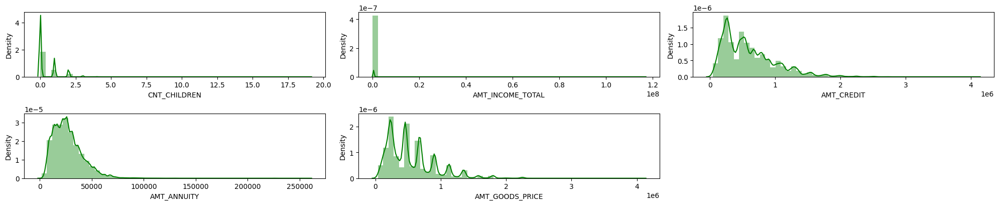

In [ ]:
# Filter out the specific warning
warnings.filterwarnings("ignore", category=UserWarning, module=".*distplot.*")

plt.figure(figsize=(20, 30))
for i in range(0, 5):
    plt.subplot(15, 3, i+1)
    sns.distplot(train[nums[i]], color='green')
    plt.tight_layout()

In [ ]:
plt.figure(figsize = (150,300))
for i in range(0, 5):
    plt.subplot(15, 3, i+1)
    sns.countplot(y =  train[nums[i]], hue =  train['TARGET'], orient = 'v')
    plt.tight_layout()

## Target Column Distribution

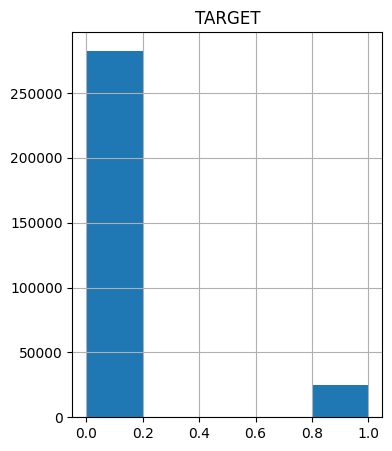

In [ ]:
train[["TARGET"]].hist(figsize=(4, 5), bins=5)
plt.show()

In [ ]:
train['TARGET'].value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

Text(0.5, 1.0, 'Distribusi Dari Variabel TARGET')

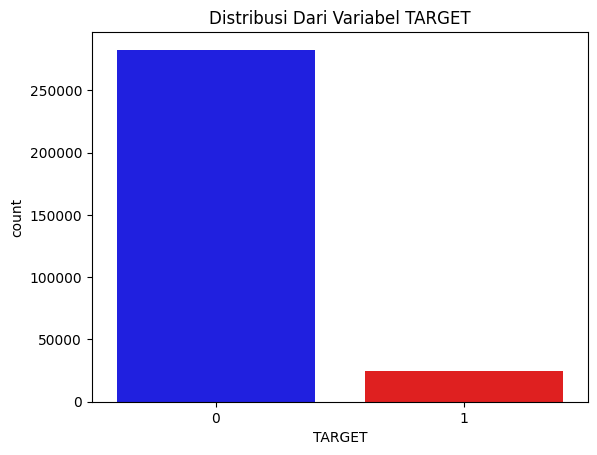

In [ ]:
sns.countplot(x=train.TARGET, palette= ["blue", "red"])
plt.title('Distribusi Dari Variabel TARGET')

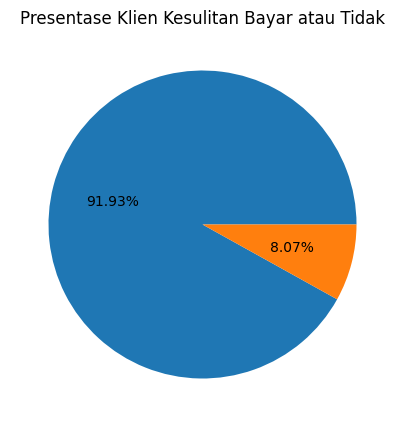

In [ ]:
plt.figure(figsize=(5,5))
plt.title('Presentase Klien Kesulitan Bayar atau Tidak')
plt.pie(train["TARGET"].value_counts(), autopct ="%.2f%%")
plt.show()

# Data Preparation

# Data Train

In [ ]:
# Menampilkan non-null count dan tipe data dataset

train.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Non-Null Count   Dtype  
---   ------                        --------------   -----  
 0    SK_ID_CURR                    307511 non-null  int64  
 1    TARGET                        307511 non-null  int64  
 2    NAME_CONTRACT_TYPE            307511 non-null  object 
 3    CODE_GENDER                   307511 non-null  object 
 4    FLAG_OWN_CAR                  307511 non-null  object 
 5    FLAG_OWN_REALTY               307511 non-null  object 
 6    CNT_CHILDREN                  307511 non-null  int64  
 7    AMT_INCOME_TOTAL              307511 non-null  float64
 8    AMT_CREDIT                    307511 non-null  float64
 9    AMT_ANNUITY                   307499 non-null  float64
 10   AMT_GOODS_PRICE               307233 non-null  float64
 11   NAME_TYPE_SUITE               306219 non-null  object 
 12   NAME_INCOME_TYPE            

Untuk fitur yang dihitung dengan AVG, MODE, dan MEDIAN yang dinormalisasi akan didrop saja dan lebih baik diubah menjadi apakah peminjam tersebut tinggal di tempat yang memiliki fitur tersebut.

In [ ]:
train['BASEMENTAREA'] = train['BASEMENTAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)
train['COMMONAREA'] = train['COMMONAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)
train['ELEVATORS'] = train['ELEVATORS_AVG'].apply(lambda x: 1 if x >= 0 else 0)
train['ENTRANCES'] = train['ENTRANCES_AVG'].apply(lambda x: 1 if x >= 0 else 0)
train['LIVINGAREA'] = train['LIVINGAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)
train['NONLIVINGAREA'] = train['NONLIVINGAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)
train['LANDAREA'] = train['LANDAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)

Nilai 1 berarti client tersebut memiliki fitur tersebut di tempat tinggalnya. Nilai 0 berarti client tersebut tidak memiliki fitur tersebut di tempat tinggalnya.

In [ ]:
train = train.drop(['APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', \
                          'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', \
                          'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', \
                          'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', \
                          'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', \
                          'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', \
                          'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', \
                          'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', \
                          'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI', 'TOTALAREA_MODE'],axis=1)

In [ ]:
train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,BASEMENTAREA,COMMONAREA,ELEVATORS,ENTRANCES,LIVINGAREA,NONLIVINGAREA,LANDAREA
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0.0,0.0,1.0,1,1,1,1,1,1,1
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0.0,0.0,0.0,1,1,1,1,1,1,1
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0.0,0.0,0.0,0,0,0,0,0,0,0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,NaN,NaN,NaN,0,0,0,0,0,0,0
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0.0,0.0,0.0,0,0,0,0,0,0,0


## Duplicate Data

In [ ]:
#Duplicated Values Checking
train.duplicated().sum()

0

## Handling Missing Value

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 86 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   307511 non-null  int64  
 1   TARGET                       307511 non-null  int64  
 2   NAME_CONTRACT_TYPE           307511 non-null  object 
 3   CODE_GENDER                  307511 non-null  object 
 4   FLAG_OWN_CAR                 307511 non-null  object 
 5   FLAG_OWN_REALTY              307511 non-null  object 
 6   CNT_CHILDREN                 307511 non-null  int64  
 7   AMT_INCOME_TOTAL             307511 non-null  float64
 8   AMT_CREDIT                   307511 non-null  float64
 9   AMT_ANNUITY                  307499 non-null  float64
 10  AMT_GOODS_PRICE              307233 non-null  float64
 11  NAME_TYPE_SUITE              306219 non-null  object 
 12  NAME_INCOME_TYPE             307511 non-null  object 
 13 

In [ ]:
#g = train.columns.to_series().groupby(train.dtypes).groups
#{k.name: v for k, v in g.items()}

In [ ]:
for i in train.columns:
  null = train[i].isnull().sum()
  tol = 0.1*len(train.index)
  if null> tol:
    train = train.drop(columns=[i])

In [ ]:
train.shape

(307511, 72)

In [ ]:
data_missing_train = pd.DataFrame(train.isnull().sum())
data_missing_train.columns = ['missing']
data_missing_train['%'] = data_missing_train.missing.apply(lambda x : round(x/train.shape[0]*100,2))
data_missing_train[data_missing_train.missing>0].sort_values('%', ascending=False)

,missing,%
NAME_TYPE_SUITE,1292,0.42
OBS_30_CNT_SOCIAL_CIRCLE,1021,0.33
DEF_30_CNT_SOCIAL_CIRCLE,1021,0.33
OBS_60_CNT_SOCIAL_CIRCLE,1021,0.33
DEF_60_CNT_SOCIAL_CIRCLE,1021,0.33
EXT_SOURCE_2,660,0.21
AMT_GOODS_PRICE,278,0.09
AMT_ANNUITY,12,0.00
CNT_FAM_MEMBERS,2,0.00
DAYS_LAST_PHONE_CHANGE,1,0.00


Setelah didrop kolom yang memiliki nilai missing value di atas 10% akan dilakukan handling missing value pada kolom yang memiliki missing value di bawah 10%. Namun sebelum menentukan metode handling akan dikelompokan menjadi data kategorik dan numerik untuk mempermudah proses handling

kelompokan data kategorik dan numerik

In [ ]:
cats_train=[i for i in train.columns if train[i].dtypes == 'object' and i!='TARGET']
cats_train

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'WEEKDAY_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'ORGANIZATION_TYPE',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_3',
 'FLAG_DOCUMENT_4',
 'FLAG_DOCUMENT_5',
 'FLAG_DOCUMENT_6',
 'FLAG_DOCUMENT_7',
 'FLAG_DOCUMENT_8',
 'FLAG_DOCUMENT_9',
 'FLAG_DOCUMENT_10',
 'FLAG_DOCUMENT_11',
 'FLAG_DOCUMENT_12',
 'FLAG_DOCUMENT_13',
 'FLAG_DOCUMENT_14',
 'FLAG_DOCUMENT_15',
 'FLAG_DOCUMENT_16',
 'FLAG_DOCUMENT_17',
 'FLAG_DOCUMENT_18',
 'FLAG_DOCUMENT_19',
 'FLAG_DOCUMENT_20',
 'FLAG_DOCUMENT_21']

In [ ]:
nums_train=[i for i in train.columns if train[i].dtypes != 'object' and i!='TARGET' and i!='SK_ID_CURR']
nums_train

['CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'CNT_FAM_MEMBERS',
 'HOUR_APPR_PROCESS_START',
 'EXT_SOURCE_2',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'BASEMENTAREA',
 'COMMONAREA',
 'ELEVATORS',
 'ENTRANCES',
 'LIVINGAREA',
 'NONLIVINGAREA',
 'LANDAREA']

Mengisi data numerik yang memiliki missing value dengan median data

In [ ]:
for i in nums_train:
  null = train[i].isnull().sum()
  notnull = 0
  if null > 0:
    train[i]=train[i].fillna(train[i].median())

Mengisi data kategorik yang memiliki missing value dengan modus

In [ ]:
for i in cats_train:
  null = train[i].isnull().sum()
  notnull = 0
  if null > 0:
    train[i]=train[i].fillna(train[i].mode()[0])

In [ ]:
data_missing_train = pd.DataFrame(train.isnull().sum())
data_missing_train.columns = ['missing']
data_missing_train['%'] = data_missing_train.missing.apply(lambda x : round(x/train.shape[0]*100,2))
data_missing_train[data_missing_train.missing>0].sort_values('%', ascending=False)

,missing,%


In [ ]:
train.isnull().sum()

SK_ID_CURR                     0
TARGET                         0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
AMT_GOODS_PRICE                0
NAME_TYPE_SUITE                0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
REGION_POPULATION_RELATIVE     0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
FLAG_MOBIL                     0
FLAG_EMP_PHONE                 0
FLAG_WORK_PHONE                0
FLAG_CONT_MOBILE               0
FLAG_PHONE                     0
FLAG_EMAIL                     0
CNT_FAM_MEMBERS                0
REGION_RATING_CLIENT           0
REGION_RATING_CLIENT_W_CITY    0
WEEKDAY_AP

Setelah dilakukan handling missing value maka sudah tidak ada nilai missing value

## Categorical Column Statistics

Pada CODE_GENDER terdapat gender 'XNA' (unknown values). Akan didrop baris yang memiliki gender XNA dan hanya menggunakan CODE_GENDER M = Male dan F =Female

In [ ]:
train[train['CODE_GENDER'] == 'XNA'].shape

(4, 72)

In [ ]:
train = train.drop(train[train['CODE_GENDER'] == 'XNA'].index)

Pada kolom NAME_FAMILY_STATUS terdapat value 'Unknown' sebanyak 2 baris. Untuk NAME_FAMILY_STATUS 'Unknown' akan didrop dan hanya digunakan yang terdefinisi saja.

In [ ]:
train[train['NAME_FAMILY_STATUS'] == 'Unknown'].shape

(2, 72)

In [ ]:
train = train.drop(train[train['NAME_FAMILY_STATUS'] == 'Unknown'].index)

Pada kolom ORGANIZATION_TYPE terdapat value 'XNA' yang berjumlah 55374 baris dari data. 'XNA' setara dengan unknown values. Baris dengan ORGANIZATION_TYPE 'XNA' tidak bisa langsung kita drop karena jumlahnya yang cukup besar. Kami akan menganggap 'XNA' sebagai null values dan akan diganti dengan modus dari ORGANIZATION_TYPE di setiap OCCUPATION_TYPE karena kedua variabel tersebut kemungkinan memiliki korelasi

In [ ]:
train[train['ORGANIZATION_TYPE'] == 'XNA'].shape

(55374, 72)

In [ ]:
train['ORGANIZATION_TYPE'].replace('XNA', np.nan, inplace=True)

In [ ]:
# Number of unique classes in each categorical column of object data type
train.select_dtypes('object').nunique()

NAME_CONTRACT_TYPE              2
CODE_GENDER                     2
FLAG_OWN_CAR                    2
FLAG_OWN_REALTY                 2
NAME_TYPE_SUITE                 7
NAME_INCOME_TYPE                8
NAME_EDUCATION_TYPE             5
NAME_FAMILY_STATUS              5
NAME_HOUSING_TYPE               6
FLAG_MOBIL                      2
FLAG_EMP_PHONE                  2
FLAG_WORK_PHONE                 2
FLAG_CONT_MOBILE                2
FLAG_PHONE                      2
FLAG_EMAIL                      2
REGION_RATING_CLIENT            3
REGION_RATING_CLIENT_W_CITY     3
WEEKDAY_APPR_PROCESS_START      7
REG_REGION_NOT_LIVE_REGION      2
REG_REGION_NOT_WORK_REGION      2
LIVE_REGION_NOT_WORK_REGION     2
REG_CITY_NOT_LIVE_CITY          2
REG_CITY_NOT_WORK_CITY          2
LIVE_CITY_NOT_WORK_CITY         2
ORGANIZATION_TYPE              57
FLAG_DOCUMENT_2                 2
FLAG_DOCUMENT_3                 2
FLAG_DOCUMENT_4                 2
FLAG_DOCUMENT_5                 2
FLAG_DOCUMENT_

In [ ]:
px.histogram(train, x='CODE_GENDER', title='Client Gender vs. Applicant Default Risk', color='TARGET',
            color_discrete_map = {0:'turquoise', 1:'midnightblue'})

In [ ]:
px.histogram(train,
             x='NAME_INCOME_TYPE',
             title='Clients Income Type vs. Applicant Default Risk',
             color='TARGET',
            color_discrete_map = {0:'steelblue', 1:'coral'})

In [ ]:
px.histogram(train,
             x='NAME_EDUCATION_TYPE',
             title='Clients Highest Education Level vs. Applicant Default Risk',
             color='TARGET',
            color_discrete_map = {0:'salmon', 1:'teal'})

In [ ]:
fig = px.pie(train, values='TARGET', names='NAME_INCOME_TYPE', title='Clients Default Risk vs. Income Type')
fig.show()

## Creating Training, Validation and Test Datasets

In [ ]:
#train_df, val_df = train_test_split(train, test_size=0.25, random_state=42)

## Identifying Input and Target Columns

In [ ]:
input_cols = list(train.columns)[0:-1]
target_col = 'TARGET'

In [ ]:
numeric_cols = train.select_dtypes(include=np.number).columns.tolist()
categorical_cols = train.select_dtypes('object').columns.tolist()

In [ ]:
print(numeric_cols)

['SK_ID_CURR', 'TARGET', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'CNT_FAM_MEMBERS', 'HOUR_APPR_PROCESS_START', 'EXT_SOURCE_2', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE', 'DAYS_LAST_PHONE_CHANGE', 'BASEMENTAREA', 'COMMONAREA', 'ELEVATORS', 'ENTRANCES', 'LIVINGAREA', 'NONLIVINGAREA', 'LANDAREA']


In [ ]:
train[numeric_cols].describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,BASEMENTAREA,COMMONAREA,ELEVATORS,ENTRANCES,LIVINGAREA,NONLIVINGAREA,LANDAREA
count,307505.000000,307505.000000,307505.00000,3.075050e+05,3.075050e+05,307505.000000,3.075050e+05,307505.000000,307505.000000,307505.000000,...,307505.000000,307505.000000,307505.000000,307505.000000,307505.000000,307505.000000,307505.000000,307505.000000,307505.000000,307505.000000
mean,278181.821811,0.080730,0.41705,1.687967e+05,5.990284e+05,27108.552152,5.383184e+05,0.020868,-16037.049495,63816.348794,...,1.400585,0.099702,-962.861163,0.414836,0.301276,0.467036,0.496509,0.498063,0.448207,0.406234
std,102790.177600,0.272421,0.72212,2.371248e+05,4.024939e+05,14493.563794,3.692909e+05,0.013831,4363.987877,141276.836143,...,2.377171,0.361666,826.812716,0.492694,0.458813,0.498913,0.499989,0.499997,0.497311,0.491130
min,100002.000000,0.000000,0.00000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,-4292.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189147.000000,0.000000,0.00000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,-1570.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278203.000000,0.000000,0.00000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,-757.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,367144.000000,0.000000,1.00000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,2.000000,0.000000,-274.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,456255.000000,1.000000,19.00000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,344.000000,24.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
print(categorical_cols)

['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'WEEKDAY_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE', 'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9', 'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15', 'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']


## Oversampling Data

In [ ]:
# Class count
count_class_0, count_class_1 = train['TARGET'].value_counts()

# Divide by class
df_class_0 = train[train['TARGET'] == 0]
df_class_1 = train[train['TARGET'] == 1]

Random over-sampling:
0    282680
1    282680
Name: TARGET, dtype: int64


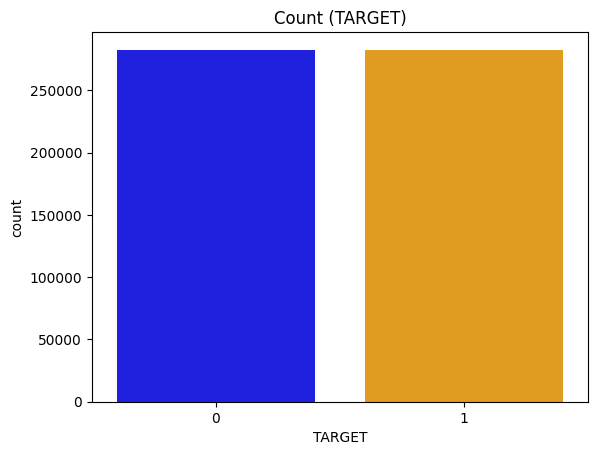

In [ ]:
df_class_1_over = df_class_1.sample(count_class_0, replace=True)
train = pd.concat([df_class_0, df_class_1_over], axis=0)

print('Random over-sampling:')
print(train['TARGET'].value_counts())

sns.countplot(x=train.TARGET, palette= ["blue", "orange"])
plt.title('Count (TARGET)');

In [ ]:
train['TARGET'].value_counts()

0    282680
1    282680
Name: TARGET, dtype: int64

## Encoding Data

In [ ]:
for i in cats_train:
    print(train[i].value_counts())

Cash loans         519338
Revolving loans     46022
Name: NAME_CONTRACT_TYPE, dtype: int64
F    349984
M    215376
Name: CODE_GENDER, dtype: int64
N    381726
Y    183634
Name: FLAG_OWN_CAR, dtype: int64
Y    389960
N    175400
Name: FLAG_OWN_REALTY, dtype: int64
Unaccompanied      461879
Family              71155
Spouse, partner     20708
Children             5864
Other_B              3621
Other_A              1615
Group of people       518
Name: NAME_TYPE_SUITE, dtype: int64
Working                 317405
Commercial associate    127114
Pensioner                86093
State servant            34599
Unemployed                  97
Maternity leave             24
Student                     18
Businessman                 10
Name: NAME_INCOME_TYPE, dtype: int64
Secondary / secondary special    421448
Higher education                 116305
Incomplete higher                 19316
Lower secondary                    8099
Academic degree                     192
Name: NAME_EDUCATION_TYPE, dtype:

Label Encoding :

- NAME_CONTRACT_TYPE
- FLAG_OWN_CAR
- FLAG_OWN_REALTY

In [ ]:
train['NAME_CONTRACT_TYPE'] = train['NAME_CONTRACT_TYPE'].astype('category').cat.codes
train['FLAG_OWN_CAR'] = train['FLAG_OWN_CAR'].astype('category').cat.codes
train['FLAG_OWN_REALTY'] = train['FLAG_OWN_REALTY'].astype('category').cat.codes

In [ ]:
train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,BASEMENTAREA,COMMONAREA,ELEVATORS,ENTRANCES,LIVINGAREA,NONLIVINGAREA,LANDAREA
1,100003,0,0,F,0,0,0,270000.0,1293502.5,35698.5,...,0,0,0,1,1,1,1,1,1,1
2,100004,0,1,M,1,1,0,67500.0,135000.0,6750.0,...,0,0,0,0,0,0,0,0,0,0
3,100006,0,0,F,0,1,0,135000.0,312682.5,29686.5,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,0,M,0,1,0,121500.0,513000.0,21865.5,...,0,0,0,0,0,0,0,0,0,0
5,100008,0,0,M,0,1,0,99000.0,490495.5,27517.5,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 565360 entries, 1 to 254314
Data columns (total 72 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   565360 non-null  int64  
 1   TARGET                       565360 non-null  int64  
 2   NAME_CONTRACT_TYPE           565360 non-null  int8   
 3   CODE_GENDER                  565360 non-null  object 
 4   FLAG_OWN_CAR                 565360 non-null  int8   
 5   FLAG_OWN_REALTY              565360 non-null  int8   
 6   CNT_CHILDREN                 565360 non-null  int64  
 7   AMT_INCOME_TOTAL             565360 non-null  float64
 8   AMT_CREDIT                   565360 non-null  float64
 9   AMT_ANNUITY                  565360 non-null  float64
 10  AMT_GOODS_PRICE              565360 non-null  float64
 11  NAME_TYPE_SUITE              565360 non-null  object 
 12  NAME_INCOME_TYPE             565360 non-null  object 
 13 

# Data Test

In [ ]:
test.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Menampilkan non-null count dan tipe data dataset
test.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Data columns (total 121 columns):
 #    Column                        Non-Null Count  Dtype  
---   ------                        --------------  -----  
 0    SK_ID_CURR                    48744 non-null  int64  
 1    NAME_CONTRACT_TYPE            48744 non-null  object 
 2    CODE_GENDER                   48744 non-null  object 
 3    FLAG_OWN_CAR                  48744 non-null  object 
 4    FLAG_OWN_REALTY               48744 non-null  object 
 5    CNT_CHILDREN                  48744 non-null  int64  
 6    AMT_INCOME_TOTAL              48744 non-null  float64
 7    AMT_CREDIT                    48744 non-null  float64
 8    AMT_ANNUITY                   48720 non-null  float64
 9    AMT_GOODS_PRICE               48744 non-null  float64
 10   NAME_TYPE_SUITE               47833 non-null  object 
 11   NAME_INCOME_TYPE              48744 non-null  object 
 12   NAME_EDUCATION_TYPE           48744 non-null

In [ ]:
test.shape

(48744, 121)

In [ ]:
test.describe()

,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,48744.000000,48744.000000,4.874400e+04,4.874400e+04,48720.000000,4.874400e+04,48744.000000,48744.000000,48744.000000,48744.000000,...,48744.000000,48744.0,48744.0,48744.0,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000
mean,277796.676350,0.397054,1.784318e+05,5.167404e+05,29426.240209,4.626188e+05,0.021226,-16068.084605,67485.366322,-4967.652716,...,0.001559,0.0,0.0,0.0,0.002108,0.001803,0.002787,0.009299,0.546902,1.983769
std,103169.547296,0.709047,1.015226e+05,3.653970e+05,16016.368315,3.367102e+05,0.014428,4325.900393,144348.507136,3552.612035,...,0.039456,0.0,0.0,0.0,0.046373,0.046132,0.054037,0.110924,0.693305,1.838873
min,100001.000000,0.000000,2.694150e+04,4.500000e+04,2295.000000,4.500000e+04,0.000253,-25195.000000,-17463.000000,-23722.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,188557.750000,0.000000,1.125000e+05,2.606400e+05,17973.000000,2.250000e+05,0.010006,-19637.000000,-2910.000000,-7459.250000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,277549.000000,0.000000,1.575000e+05,4.500000e+05,26199.000000,3.960000e+05,0.018850,-15785.000000,-1293.000000,-4490.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,367555.500000,1.000000,2.250000e+05,6.750000e+05,37390.500000,6.300000e+05,0.028663,-12496.000000,-296.000000,-1901.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000
max,456250.000000,20.000000,4.410000e+06,2.245500e+06,180576.000000,2.245500e+06,0.072508,-7338.000000,365243.000000,0.000000,...,1.000000,0.0,0.0,0.0,2.000000,2.000000,2.000000,6.000000,7.000000,17.000000


In [ ]:
test['BASEMENTAREA'] = test['BASEMENTAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)
test['COMMONAREA'] = test['COMMONAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)
test['ELEVATORS'] = test['ELEVATORS_AVG'].apply(lambda x: 1 if x >= 0 else 0)
test['ENTRANCES'] = test['ENTRANCES_AVG'].apply(lambda x: 1 if x >= 0 else 0)
test['LIVINGAREA'] = test['LIVINGAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)
test['NONLIVINGAREA'] = test['NONLIVINGAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)
test['LANDAREA'] = test['LANDAREA_AVG'].apply(lambda x: 1 if x >= 0 else 0)

In [ ]:
test = test.drop(['APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', \
                          'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', \
                          'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', \
                          'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', \
                          'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', \
                          'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', \
                          'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', \
                          'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', \
                          'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI', 'TOTALAREA_MODE'],axis=1)

In [ ]:
test.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,BASEMENTAREA,COMMONAREA,ELEVATORS,ENTRANCES,LIVINGAREA,NONLIVINGAREA,LANDAREA
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0.0,0.0,0.0,1,0,0,1,1,0,0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0.0,0.0,3.0,0,0,0,0,0,0,0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0.0,1.0,4.0,0,0,0,0,0,0,0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0.0,0.0,3.0,1,1,1,1,1,1,1
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,NaN,NaN,NaN,0,0,0,0,0,0,0


## Duplicate Data

In [ ]:
#Duplicated Values Checking
test.duplicated().sum()

0

## Handling Missing Value

In [ ]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Data columns (total 85 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   SK_ID_CURR                   48744 non-null  int64  
 1   NAME_CONTRACT_TYPE           48744 non-null  object 
 2   CODE_GENDER                  48744 non-null  object 
 3   FLAG_OWN_CAR                 48744 non-null  object 
 4   FLAG_OWN_REALTY              48744 non-null  object 
 5   CNT_CHILDREN                 48744 non-null  int64  
 6   AMT_INCOME_TOTAL             48744 non-null  float64
 7   AMT_CREDIT                   48744 non-null  float64
 8   AMT_ANNUITY                  48720 non-null  float64
 9   AMT_GOODS_PRICE              48744 non-null  float64
 10  NAME_TYPE_SUITE              47833 non-null  object 
 11  NAME_INCOME_TYPE             48744 non-null  object 
 12  NAME_EDUCATION_TYPE          48744 non-null  object 
 13  NAME_FAMILY_STAT

In [ ]:
#g = test.columns.to_series().groupby(test.dtypes).groups
#{k.name: v for k, v in g.items()}

In [ ]:
for i in test.columns:
  null = test[i].isnull().sum()
  tol = 0.1*len(test.index)
  if null> tol:
    test = test.drop(columns=[i])

In [ ]:
data_missing_test = pd.DataFrame(test.isnull().sum())
data_missing_test.columns = ['missing']
data_missing_test['%'] = data_missing_test.missing.apply(lambda x : round(x/test.shape[0]*100,2))
data_missing_test[data_missing_test.missing>0].sort_values('%', ascending=False)

,missing,%
NAME_TYPE_SUITE,911,1.87
OBS_30_CNT_SOCIAL_CIRCLE,29,0.06
DEF_30_CNT_SOCIAL_CIRCLE,29,0.06
OBS_60_CNT_SOCIAL_CIRCLE,29,0.06
DEF_60_CNT_SOCIAL_CIRCLE,29,0.06
AMT_ANNUITY,24,0.05
EXT_SOURCE_2,8,0.02


In [ ]:
cats_test=[i for i in test.columns if test[i].dtypes == 'object' and i!='TARGET']
cats_test

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE']

In [ ]:
nums_test=[i for i in test.columns if test[i].dtypes != 'object' and i!='TARGET' and i!='SK_ID_CURR']
nums_test

['CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_2',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_3',
 'FLAG_DOCUMENT_4',
 'FLAG_DOCUMENT_5',
 'FLAG_DOCUMENT_6',
 'FLAG_DOCUMENT_7',
 'FLAG_DOCUMENT_8',
 'FLAG_DOCUMENT_9',
 'FLAG_DOCUMENT_10',
 'FLAG_DOCUMENT_11',
 'FLAG_DOCUMENT_12',
 'FLAG_DOCUMENT_13',
 'FLAG_DOCUMENT

Mengisi data numerik yang memiliki missing value dengan median data

In [ ]:
for i in nums_test:
  null = test[i].isnull().sum()
  notnull = 0
  if null > 0:
    test[i]=test[i].fillna(test[i].median())

Mengisi data kategorik yang memiliki missing value dengan modus

In [ ]:
for i in cats_test:
  null = test[i].isnull().sum()
  notnull = 0
  if null > 0:
    test[i]=test[i].fillna(test[i].mode()[0])

In [ ]:
data_missing_test = pd.DataFrame(test.isnull().sum())
data_missing_test.columns = ['missing']
data_missing_test['%'] = data_missing_test.missing.apply(lambda x : round(x/test.shape[0]*100,2))
data_missing_test[data_missing_test.missing>0].sort_values('%', ascending=False)

,missing,%


In [ ]:
test.isnull().sum()

SK_ID_CURR                     0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
AMT_GOODS_PRICE                0
NAME_TYPE_SUITE                0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
REGION_POPULATION_RELATIVE     0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
FLAG_MOBIL                     0
FLAG_EMP_PHONE                 0
FLAG_WORK_PHONE                0
FLAG_CONT_MOBILE               0
FLAG_PHONE                     0
FLAG_EMAIL                     0
CNT_FAM_MEMBERS                0
REGION_RATING_CLIENT           0
REGION_RATING_CLIENT_W_CITY    0
WEEKDAY_APPR_PROCESS_START     0
HOUR_APPR_

Setelah dilakukan handling missing value maka sudah tidak ada nilai missing value

## Categorical Column Statistics

In [ ]:
test[test['CODE_GENDER'] == 'XNA'].shape

(0, 71)

In [ ]:
test = test.drop(test[test['CODE_GENDER'] == 'XNA'].index)

In [ ]:
 test[test['NAME_FAMILY_STATUS'] == 'Unknown'].shape

(0, 71)

In [ ]:
 test = test.drop(test[test['NAME_FAMILY_STATUS'] == 'Unknown'].index)

In [ ]:
test[test['ORGANIZATION_TYPE'] == 'XNA'].shape

(9274, 71)

In [ ]:
 test['ORGANIZATION_TYPE'].replace('XNA', np.nan, inplace=True)

In [ ]:
# Number of unique classes in each categorical column of object data type
test.select_dtypes('object').nunique()

NAME_CONTRACT_TYPE             2
CODE_GENDER                    2
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               7
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             5
NAME_HOUSING_TYPE              6
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             57
dtype: int64

## Encoding Data

In [ ]:
for i in cats_test:
    print(test[i].value_counts())

Cash loans         48305
Revolving loans      439
Name: NAME_CONTRACT_TYPE, dtype: int64
F    32678
M    16066
Name: CODE_GENDER, dtype: int64
N    32311
Y    16433
Name: FLAG_OWN_CAR, dtype: int64
Y    33658
N    15086
Name: FLAG_OWN_REALTY, dtype: int64
Unaccompanied      40638
Family              5881
Spouse, partner     1448
Children             408
Other_B              211
Other_A              109
Group of people       49
Name: NAME_TYPE_SUITE, dtype: int64
Working                 24533
Commercial associate    11402
Pensioner                9273
State servant            3532
Student                     2
Businessman                 1
Unemployed                  1
Name: NAME_INCOME_TYPE, dtype: int64
Secondary / secondary special    33988
Higher education                 12516
Incomplete higher                 1724
Lower secondary                    475
Academic degree                     41
Name: NAME_EDUCATION_TYPE, dtype: int64
Married                 32283
Single / not married 

In [ ]:
test['NAME_CONTRACT_TYPE'] = test['NAME_CONTRACT_TYPE'].astype('category').cat.codes
test['FLAG_OWN_CAR'] = test['FLAG_OWN_CAR'].astype('category').cat.codes
test['FLAG_OWN_REALTY'] = test['FLAG_OWN_REALTY'].astype('category').cat.codes

In [ ]:
test.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,BASEMENTAREA,COMMONAREA,ELEVATORS,ENTRANCES,LIVINGAREA,NONLIVINGAREA,LANDAREA
0,100001,0,F,0,1,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,1,0,0,1,1,0,0
1,100005,0,M,0,1,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0,0,0,0,0,0
2,100013,0,M,1,1,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0,0,0,0,0,0
3,100028,0,F,0,1,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,1,1,1,1,1,1,1
4,100038,0,M,1,0,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Data columns (total 71 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   SK_ID_CURR                   48744 non-null  int64  
 1   NAME_CONTRACT_TYPE           48744 non-null  int8   
 2   CODE_GENDER                  48744 non-null  object 
 3   FLAG_OWN_CAR                 48744 non-null  int8   
 4   FLAG_OWN_REALTY              48744 non-null  int8   
 5   CNT_CHILDREN                 48744 non-null  int64  
 6   AMT_INCOME_TOTAL             48744 non-null  float64
 7   AMT_CREDIT                   48744 non-null  float64
 8   AMT_ANNUITY                  48744 non-null  float64
 9   AMT_GOODS_PRICE              48744 non-null  float64
 10  NAME_TYPE_SUITE              48744 non-null  object 
 11  NAME_INCOME_TYPE             48744 non-null  object 
 12  NAME_EDUCATION_TYPE          48744 non-null  object 
 13  NAME_FAMILY_STAT

# Exploratory Data Analysis

## Anomalies

In [ ]:
(train['DAYS_BIRTH'] / -365).describe()

count    565360.000000
mean         42.491432
std          11.840718
min          20.517808
25%          32.517808
50%          41.268493
75%          52.098630
max          69.120548
Name: DAYS_BIRTH, dtype: float64

In [ ]:
train['DAYS_EMPLOYED']

1          -1188
2           -225
3          -3039
4          -3038
5          -1588
6          -3130
7           -449
8         365243
9          -2019
10          -679
11        365243
12         -2717
13         -3028
14          -203
15         -1157
16         -1317
17          -191
18         -7804
19         -2038
20         -4286
21         -1652
22         -4306
23        365243
24          -746
25         -3494
27         -1234
28         -1796
29         -1010
30         -2668
31         -1104
32         -4404
33         -2060
34         -4585
35         -1275
36          -768
37         -1288
38        365243
39         -1761
41          -475
43        365243
44          -758
45          -895
46        365243
47         -5332
48         -4411
49         -9523
50         -1176
51         -6977
52          -778
53         -1392
54        365243
55         -4106
56        365243
57         -2351
58         -1743
59         -2091
60         -2446
61         -1324
62        3652

In [ ]:
train['DAYS_EMPLOYED'].describe()

count    565360.000000
mean      53882.903791
std      132058.265069
min      -17912.000000
25%       -2475.000000
50%       -1120.000000
75%        -337.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

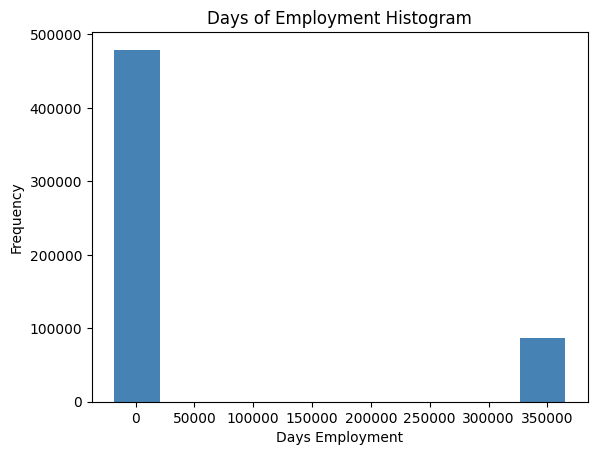

In [ ]:
train['DAYS_EMPLOYED'].plot.hist(title = 'Days of Employment Histogram', color="steelblue");
plt.xlabel('Days Employment');

In [ ]:
anom = train[train['DAYS_EMPLOYED'] == 365243]
non_anom = train[train['DAYS_EMPLOYED'] != 365243]
print("The non-anomalies default on {:0.2f}% of loans".format(100 * non_anom['TARGET'].mean()))
print("The anomalies default on {:0.2f}% of loans".format(100 * anom['TARGET'].mean()))
print("There are {:d} anomalous days of employment".format(len(anom)))
# print("Accuracy: {:.2f}%".format(accuracy * 100))

The non-anomalies default on 51.94% of loans
The anomalies default on 39.22% of loans
There are 86180 anomalous days of employment


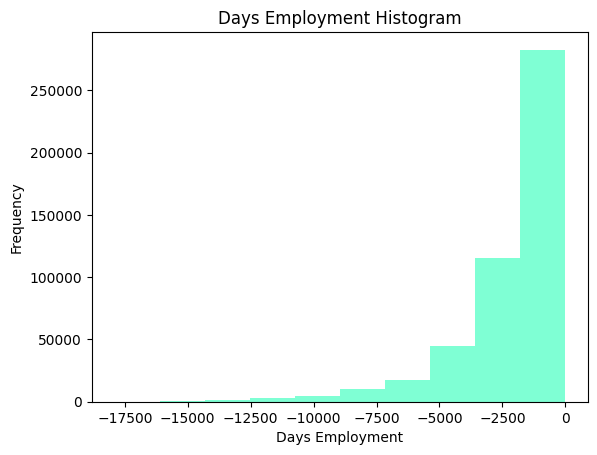

In [ ]:
# Create an anomalous flag column 'DAYS_EMPLOYED_ANOM'
train['DAYS_EMPLOYED_ANOM'] = train["DAYS_EMPLOYED"] == 365243
# Replace the anomalous values with nan
train['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)
train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram', color="aquamarine");
plt.xlabel('Days Employment');

In [ ]:
# Convert DAYS_BIRTH to years
#train['AGE'] = round(abs(train['DAYS_BIRTH'] / (365)))

# Convert DAYS_LAST_PHONE_CHANGE to years
#train['PHONE_CHANGE_YEARS'] = round(abs(train['DAYS_LAST_PHONE_CHANGE'] / (365)))

# Convert DAYS_EMPLOYED to years
#train['YEARS_EMPLOYED'] = round(abs(train['DAYS_EMPLOYED'] / (365)))

# Remove unneeded columns
#train = train.drop(['DAYS_BIRTH', 'DAYS_LAST_PHONE_CHANGE', 'DAYS_EMPLOYED'], axis = 1)

In [ ]:
# Select sample of dataset for visualizations
train30k = train.sample(frac = 0.10, replace = False, random_state = 1)

In [ ]:
# Build function for boxplots
def class_box(feature):
    plt.subplots(figsize=(10, 6))
    sns.boxplot(data = train30k, x = train30k[feature], y = train30k.TARGET, orient = "h")
    plt.title(f'Boxplot for {feature} by Class')
    plt.show()

In [ ]:
# Build function for histograms
def class_hist(feature):
    plt.subplots(figsize=(10, 6))
    sns.histplot(data = train30k, x = train30k[feature], color = 'green')
    plt.title(f'Distribution of {feature} among Borrowers')
    plt.show()

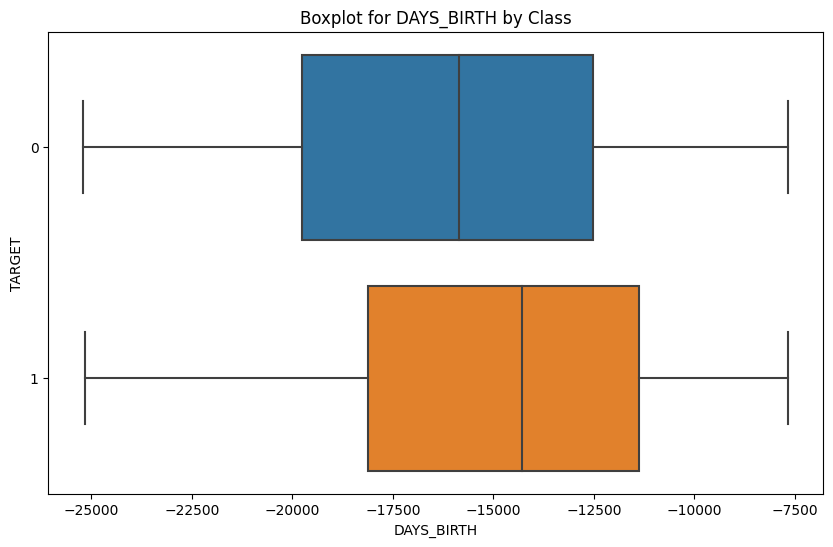

In [ ]:
class_box('DAYS_BIRTH')

## Correlation

In [ ]:
pd.set_option('display.max_rows', 100) #menampilkan maksimal row
app_df_corr_TARGET=train.corr()['TARGET'].sort_values(ascending=False).reset_index() #menampilkan nilai korelasi seluruh variabel dengan variabel sale price
app_df_corr_TARGET #menampilkan nilai korelasi

,index,TARGET
0,TARGET,1.000000
1,DAYS_BIRTH,0.145508
2,DAYS_EMPLOYED,0.145288
3,DAYS_LAST_PHONE_CHANGE,0.105098
4,DAYS_ID_PUBLISH,0.094660
5,DAYS_REGISTRATION,0.080530
6,DEF_30_CNT_SOCIAL_CIRCLE,0.056040
7,DEF_60_CNT_SOCIAL_CIRCLE,0.053337
8,CNT_CHILDREN,0.036523
9,CNT_FAM_MEMBERS,0.018933


In [ ]:
# Find correlations of features with the target variable and sort
correlations = train.corr()['TARGET'].sort_values(ascending=False)

# Display highest correlations in both directions
print('Most Positive Correlations:\n', correlations.head(15))
print('\nMost Negative Correlations:\n', correlations.tail(15))

Most Positive Correlations:
 TARGET                      1.000000
DAYS_BIRTH                  0.145508
DAYS_EMPLOYED               0.145288
DAYS_LAST_PHONE_CHANGE      0.105098
DAYS_ID_PUBLISH             0.094660
DAYS_REGISTRATION           0.080530
DEF_30_CNT_SOCIAL_CIRCLE    0.056040
DEF_60_CNT_SOCIAL_CIRCLE    0.053337
CNT_CHILDREN                0.036523
CNT_FAM_MEMBERS             0.018933
OBS_30_CNT_SOCIAL_CIRCLE    0.016829
OBS_60_CNT_SOCIAL_CIRCLE    0.016672
SK_ID_CURR                 -0.005404
AMT_INCOME_TOTAL           -0.005654
FLAG_OWN_REALTY            -0.010270
Name: TARGET, dtype: float64

Most Negative Correlations:
 FLAG_OWN_CAR                 -0.039220
HOUR_APPR_PROCESS_START      -0.044505
COMMONAREA                   -0.052624
AMT_CREDIT                   -0.059447
NAME_CONTRACT_TYPE           -0.060259
LANDAREA                     -0.061412
BASEMENTAREA                 -0.068205
REGION_POPULATION_RELATIVE   -0.072687
NONLIVINGAREA                -0.072855
LIVING

In [ ]:
data_app=train[['SK_ID_CURR','TARGET','REGION_RATING_CLIENT','REGION_RATING_CLIENT_W_CITY','EXT_SOURCE_2','REG_CITY_NOT_WORK_CITY','FLAG_EMP_PHONE']]
data_app

,SK_ID_CURR,TARGET,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,EXT_SOURCE_2,REG_CITY_NOT_WORK_CITY,FLAG_EMP_PHONE
1,100003,0,1,1,0.622246,0,1
2,100004,0,2,2,0.555912,0,1
3,100006,0,2,2,0.650442,0,1
4,100007,0,2,2,0.322738,1,1
5,100008,0,2,2,0.354225,0,1
...,...,...,...,...,...,...,...
92469,207376,1,2,2,0.235290,1,1
90076,204577,1,2,2,0.150132,0,1
107850,225119,1,2,2,0.744682,1,1
195319,326483,1,1,1,0.637154,0,1


**Korelasi fitur CODE_GENDER dengan TARGET**

<Axes: xlabel='TARGET', ylabel='count'>

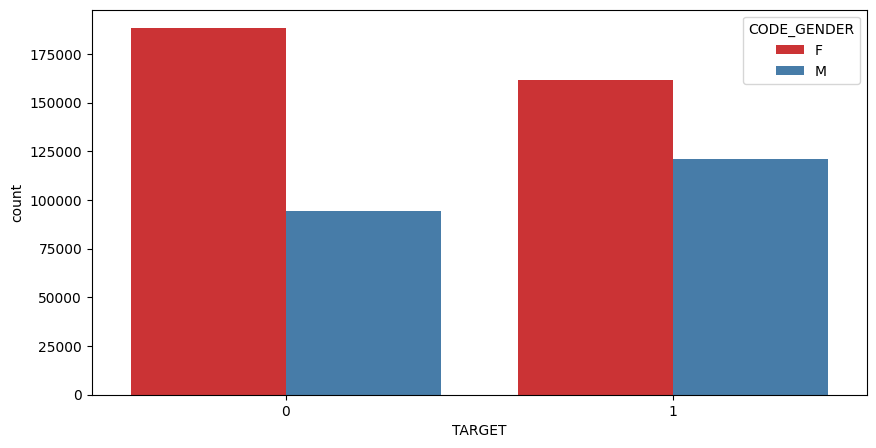

In [ ]:
fig, ax = plt.subplots(figsize=(10,5))
sns.countplot( x='TARGET', hue='CODE_GENDER', data=train, palette="Set1")

## Effect of Age on Repayment Capability

In [ ]:
# Find the correlation of the positive days since birth and target
train['AGE'] = abs(train['DAYS_BIRTH'])
train['AGE'].corr(train['TARGET'])

-0.14550805084143936

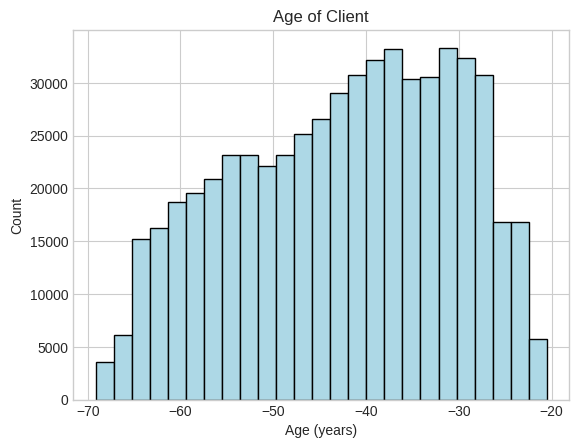

In [ ]:
# Set the style of plots
plt.style.use('seaborn-whitegrid')

# Plot the distribution of ages in years
plt.hist(train['DAYS_BIRTH'] / 365, edgecolor = 'k', bins = 25, color='lightblue')
plt.title('Age of Client');
plt.xlabel('Age (years)');
plt.ylabel('Count');

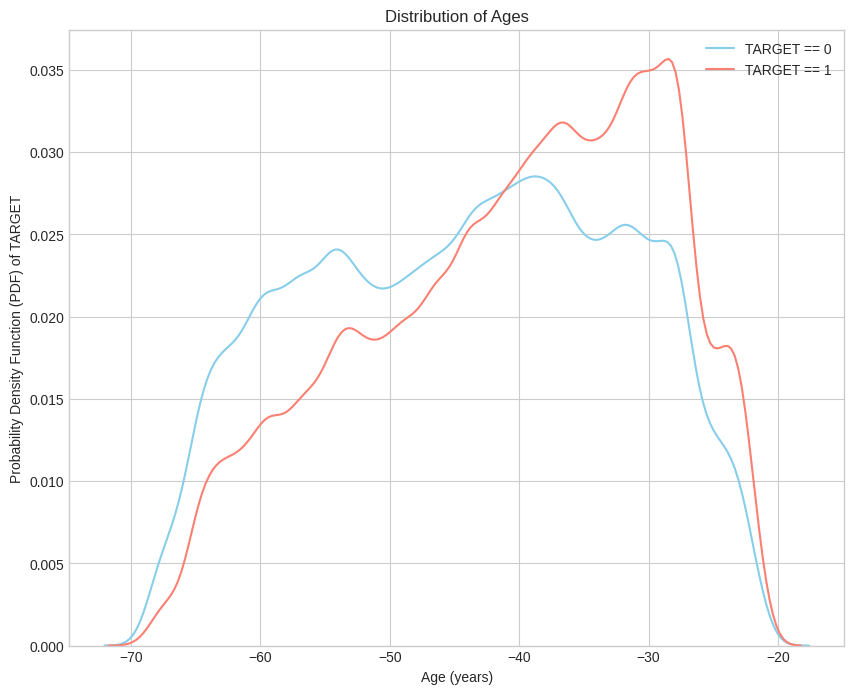

In [ ]:
# Set plot configuration
plt.style.use('seaborn-whitegrid')
plt.figure(figsize = (10, 8))

# KDE plot of loans repaid on time
sns.kdeplot(train.loc[train['TARGET'] == 0, 'DAYS_BIRTH'] / 365, label = 'TARGET == 0', color='skyblue')

# KDE plot of loans not repaid on time
sns.kdeplot(train.loc[train['TARGET'] == 1, 'DAYS_BIRTH'] / 365, label = 'TARGET == 1', color='salmon')

# Plot Labeling
plt.xlabel('Age (years)');
plt.ylabel('Probability Density Function (PDF) of TARGET');
plt.title('Distribution of Ages');
plt.legend()

In [ ]:
# Age information into a separate dataframe
# DAYS_BIRTH: Client's age in days at the time of application
age_data = train[['TARGET', 'AGE']]
age_data['YEARS_BIRTH'] = age_data['AGE'] / 365

# Binning the age data
age_data['YEARS_BINNED'] = pd.cut(age_data['YEARS_BIRTH'], bins = np.linspace(20, 70, num = 11))
age_data.head(10)

,TARGET,AGE,YEARS_BIRTH,YEARS_BINNED
1,0,16765,45.931507,"(45.0, 50.0]"
2,0,19046,52.180822,"(50.0, 55.0]"
3,0,19005,52.068493,"(50.0, 55.0]"
4,0,19932,54.608219,"(50.0, 55.0]"
5,0,16941,46.413699,"(45.0, 50.0]"
6,0,13778,37.747945,"(35.0, 40.0]"
7,0,18850,51.643836,"(50.0, 55.0]"
8,0,20099,55.065753,"(55.0, 60.0]"
9,0,14469,39.641096,"(35.0, 40.0]"
10,0,10197,27.936986,"(25.0, 30.0]"


In [ ]:
# Group by the bin and calculate averages
age_groups  = age_data.groupby('YEARS_BINNED').mean()
age_groups

,TARGET,AGE,YEARS_BIRTH
YEARS_BINNED,,,
"(20.0, 25.0]",0.613813,8523.059867,23.350849
"(25.0, 30.0]",0.588169,10161.509351,27.839752
"(30.0, 35.0]",0.565867,11844.509110,32.450710
"(35.0, 40.0]",0.528182,13694.320806,37.518687
"(40.0, 45.0]",0.495751,15495.883836,42.454476
"(45.0, 50.0]",0.474695,17320.654076,47.453847
"(50.0, 55.0]",0.451015,19186.574546,52.565958
"(55.0, 60.0]",0.399562,20981.518203,57.483612
"(60.0, 65.0]",0.384370,22784.010100,62.421945


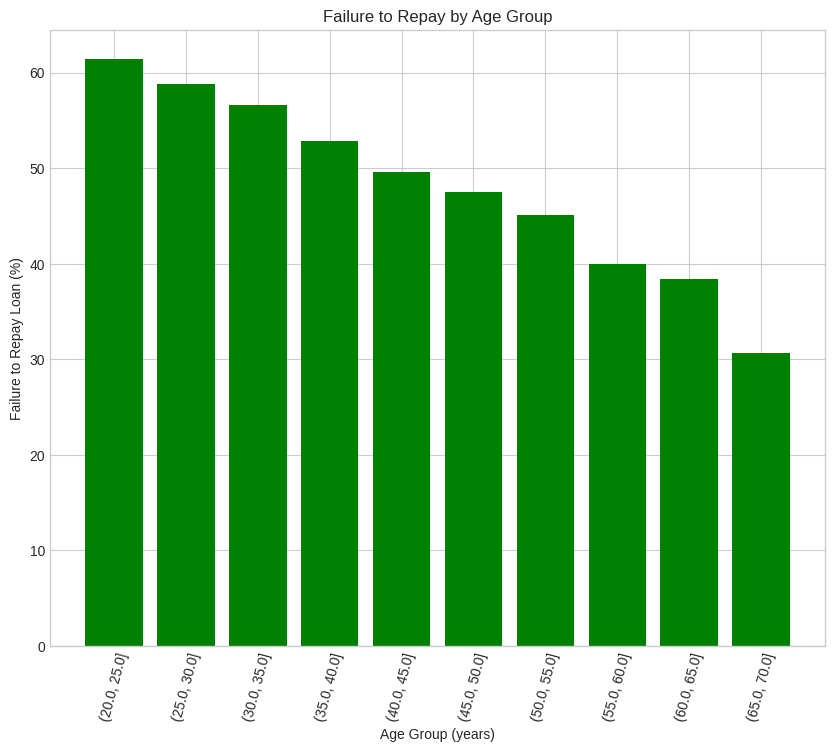

In [ ]:
plt.figure(figsize = (10, 8))

# Plot the age bins and the average of the TARGET as a bar plot
plt.bar(age_groups.index.astype(str), 100 * age_groups['TARGET'], color='green')

# Plot labeling
plt.xticks(rotation = 75);
plt.xlabel('Age Group (years)');
plt.ylabel('Failure to Repay Loan (%)')
plt.title('Failure to Repay by Age Group');

## Most negative correlations with TARGET

In [ ]:
# Extract the EXT_SOURCE_n variables and exhibit the corresponding Correlations
# 'EXT_SOURCE_n': Normalized score from external data source
ext_data = train[['TARGET', 'EXT_SOURCE_2', 'DAYS_BIRTH']]
ext_data_corrs = ext_data.corr()
ext_data_corrs

,TARGET,EXT_SOURCE_2,DAYS_BIRTH
TARGET,1.000000,-0.270530,0.145508
EXT_SOURCE_2,-0.270530,1.000000,-0.128362
DAYS_BIRTH,0.145508,-0.128362,1.000000


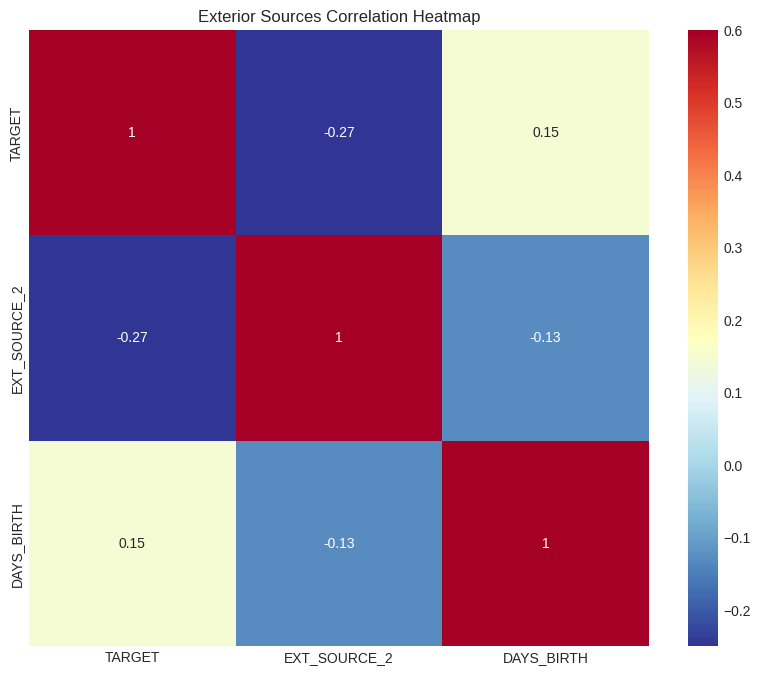

In [ ]:
plt.figure(figsize = (10, 8))

# Correlation Heatmap of the Exterior Sources
sns.heatmap(ext_data_corrs, cmap = plt.cm.RdYlBu_r, vmin = -0.25, annot = True, vmax = 0.6)
plt.title('Exterior Sources Correlation Heatmap');

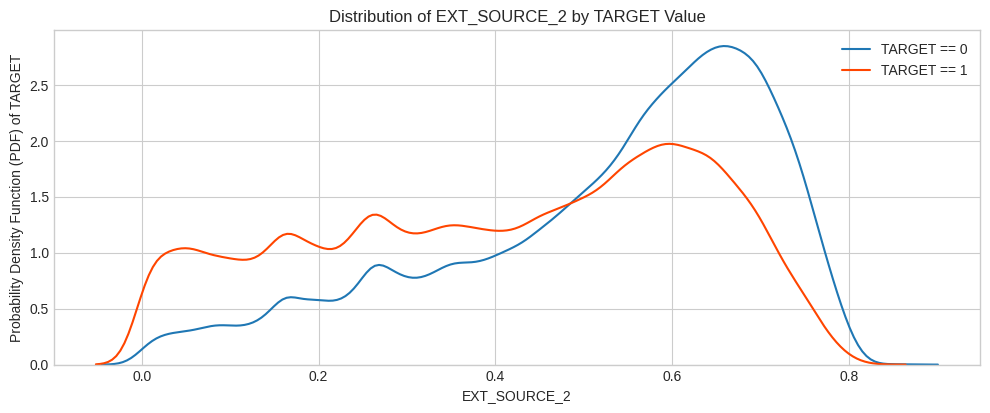

In [ ]:
plt.figure(figsize = (10, 12))

# iterate through the external sources 'EXT_SOURCE_n'
for i, ext_source in enumerate(['EXT_SOURCE_2']):

    # create a new subplot for each source
    plt.subplot(3, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(train.loc[train['TARGET'] == 0, ext_source], label = 'TARGET == 0')
    # plot loans that were not repaid
    sns.kdeplot(train.loc[train['TARGET'] == 1, ext_source], label = 'TARGET == 1', color='orangered')

    # Label the plots
    plt.title('Distribution of %s by TARGET Value' % ext_source)
    plt.xlabel('%s' % ext_source);
    plt.ylabel('Probability Density Function (PDF) of TARGET');
    plt.legend()

plt.tight_layout(h_pad = 2.5)

In [ ]:
train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_21,BASEMENTAREA,COMMONAREA,ELEVATORS,ENTRANCES,LIVINGAREA,NONLIVINGAREA,LANDAREA,DAYS_EMPLOYED_ANOM,AGE
1,100003,0,0,F,0,0,0,270000.0,1293502.5,35698.5,...,0,1,1,1,1,1,1,1,False,16765
2,100004,0,1,M,1,1,0,67500.0,135000.0,6750.0,...,0,0,0,0,0,0,0,0,False,19046
3,100006,0,0,F,0,1,0,135000.0,312682.5,29686.5,...,0,0,0,0,0,0,0,0,False,19005
4,100007,0,0,M,0,1,0,121500.0,513000.0,21865.5,...,0,0,0,0,0,0,0,0,False,19932
5,100008,0,0,M,0,1,0,99000.0,490495.5,27517.5,...,0,0,0,0,0,0,0,0,False,16941


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 565360 entries, 1 to 254314
Data columns (total 74 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   SK_ID_CURR                   565360 non-null  int64  
 1   TARGET                       565360 non-null  int64  
 2   NAME_CONTRACT_TYPE           565360 non-null  int8   
 3   CODE_GENDER                  565360 non-null  object 
 4   FLAG_OWN_CAR                 565360 non-null  int8   
 5   FLAG_OWN_REALTY              565360 non-null  int8   
 6   CNT_CHILDREN                 565360 non-null  int64  
 7   AMT_INCOME_TOTAL             565360 non-null  float64
 8   AMT_CREDIT                   565360 non-null  float64
 9   AMT_ANNUITY                  565360 non-null  float64
 10  AMT_GOODS_PRICE              565360 non-null  float64
 11  NAME_TYPE_SUITE              565360 non-null  object 
 12  NAME_INCOME_TYPE             565360 non-null  object 
 13 

Distribution of AMT_CREDIT

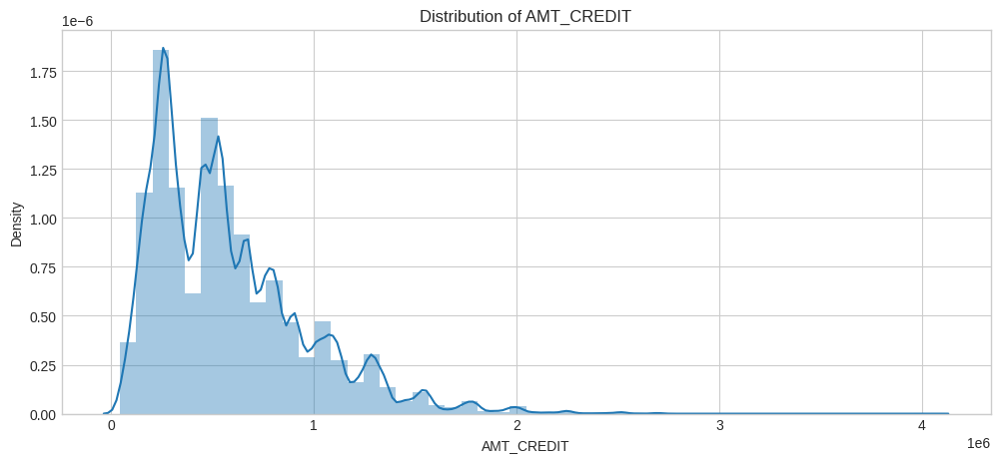

In [ ]:
plt.figure(figsize=(12,5))
plt.title("Distribution of AMT_CREDIT")
ax = sns.distplot(train["AMT_CREDIT"])

Distribution of AMT_GOODS_PRICE

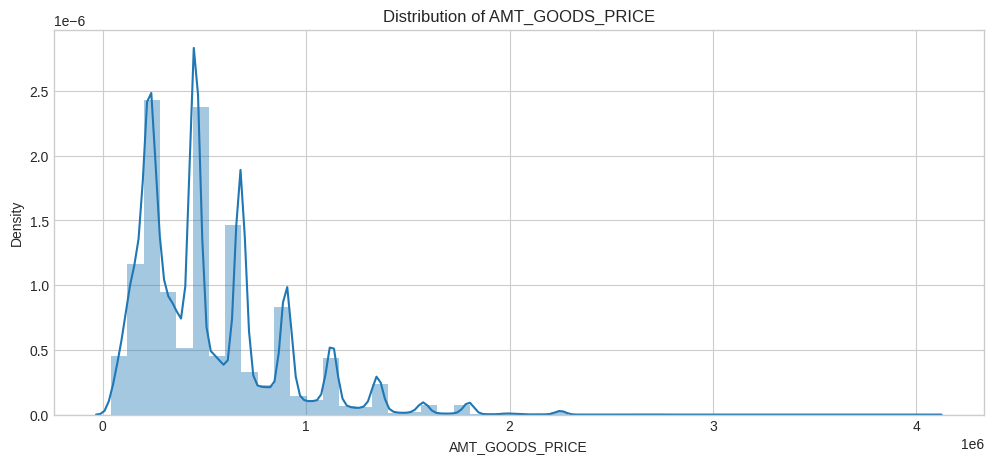

In [ ]:
plt.figure(figsize=(12,5))
plt.title("Distribution of AMT_GOODS_PRICE")
ax = sns.distplot(train["AMT_GOODS_PRICE"].dropna())

## Pinjaman (Loan) terhadap TARGET

In [ ]:
corr1=round(train.AMT_CREDIT.corr(train.AMT_GOODS_PRICE),2)
corr2=round(train.AMT_ANNUITY.corr(train.AMT_CREDIT),2)
corr3=round(train.AMT_ANNUITY.corr(train.AMT_GOODS_PRICE),2)

print('Korelasi dari Credit amount vs Price of goods:',corr1)
print('Korelasi dari Annuity amount vs Credit amount:',corr2)
print('Korelasi dari Annuity amount vs Price of goods:',corr3)

Korelasi dari Credit amount vs Price of goods: 0.99
Korelasi dari Annuity amount vs Credit amount: 0.76
Korelasi dari Annuity amount vs Price of goods: 0.77


*   AMT_CREDIT dan AMT_GOODS_PRICE berkorelasi tinggi sebesar 0.99. Hal ini masuk akal karena price of goods yang semakin tinggi, jumlah kredit pinjaman  juga semakin tinggi. Sehingga kita dapat menghapus kolom AMT_GOODS_PRICE kaarena kita sudah memiliki AMT_CREDIT

*   AMT_ANNUITY juga sangat berkorelasi dengan AMT_CREDIT dan AMT_GOODS_PRICE dengan linearitas positif. Itu karena anuitas adalah jumlah jatuh tempo bulanan.


## Detail Pengajuan Terhadap Target

Waktu pengajuan pinjaman klien

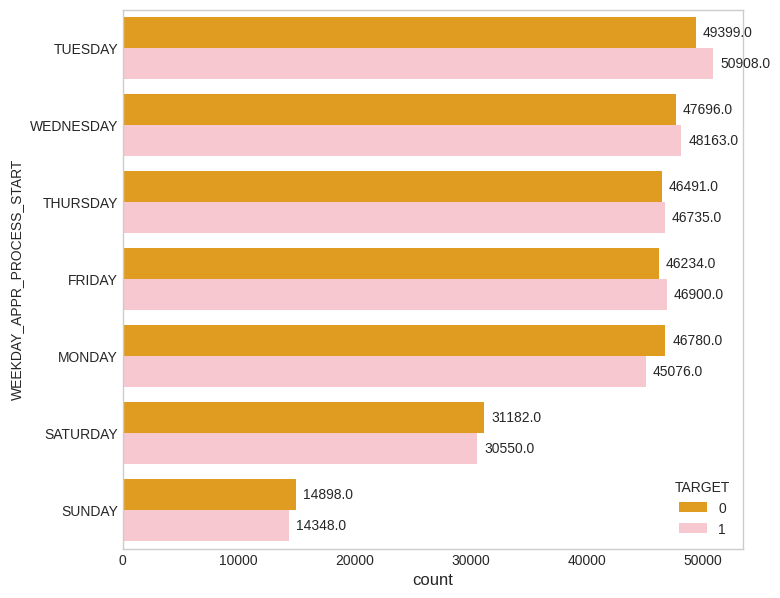

In [ ]:
f, ax = plt.subplots(figsize=(8, 7))

clrs = ['pink' if (x < max(train['WEEKDAY_APPR_PROCESS_START'].value_counts())) else 'orange' for x in train['WEEKDAY_APPR_PROCESS_START'].value_counts() ]

sns.countplot(y="WEEKDAY_APPR_PROCESS_START", data=train, hue='TARGET',palette=clrs,order =train['WEEKDAY_APPR_PROCESS_START'].value_counts().index)

for p in ax.patches:
  ax.annotate(p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
              xytext=(5, 0), textcoords='offset points', ha="left", va="center")

plt.grid(color='white', axis='x', linestyle='-', linewidth=0.5)
plt.xlabel('count', fontsize=12)
plt.show()

## Kondisi Rumah Tangga Klien terhadap TARGET

Status Pernikahan Klien

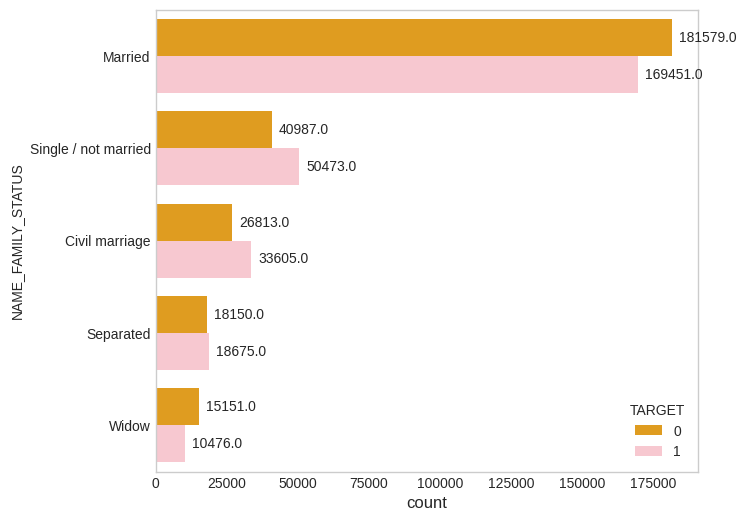

In [ ]:
f, ax = plt.subplots(figsize=(7, 6))

clrs = ['pink' if (x < max(train['NAME_FAMILY_STATUS'].value_counts())) else 'orange' for x in train['NAME_FAMILY_STATUS'].value_counts() ]

sns.countplot(y="NAME_FAMILY_STATUS", data=train, hue='TARGET',palette=clrs,order =train['NAME_FAMILY_STATUS'].value_counts().index)

for p in ax.patches:
  ax.annotate(p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
              xytext=(5, 0), textcoords='offset points', ha="left", va="center")

plt.grid(color='white', axis='x', linestyle='-', linewidth=0.5)
plt.xlabel('count', fontsize=12)
plt.show()

Anggota Keluarga Klien

In [ ]:
train[['CNT_CHILDREN','NAME_FAMILY_STATUS','CNT_FAM_MEMBERS']][train.NAME_FAMILY_STATUS=='Married'].tail()

,CNT_CHILDREN,NAME_FAMILY_STATUS,CNT_FAM_MEMBERS
203344,0,Married,2.0
17855,3,Married,5.0
215034,0,Married,2.0
90770,0,Married,2.0
107850,0,Married,2.0


* Berdasarkan output di atas, dapat diketahui bahwa mayoritas klien memiliki status married. Pelanggan yang tidak dapat membayar tagihan juga paling banyak berasal dari status Married

* 'CNT_CHILDREN', 'NAME_FAMILY_STATUS', 'CNT_FAM_MEMBERS' adalah kolom-kolom yang berhubungan dengan ukuran keluarga. Apabila ingin melihat pengeluaran klien berdasarkan ukuran keluarganya, dapat menggunakan kolom 'CNT_FAM_MEMBERS' yang memperhitungkan pelanggan itu sendiri, ditambah pasangan (jika ada), ditambah jumlah anak (jika ada)

# Save Data

In [ ]:
# Assuming you have a DataFrame named train
train.to_csv('Data_Application_Train.csv', index=False)

# Data Analysis (Modelling dan Evaluation)

## Modelling

### Logistic Regression

In [ ]:
train = pd.read_csv("application_train.csv")
test = pd.read_csv("application_test.csv")

train.fillna(train.mean(), inplace=True)
test.fillna(test.mean(), inplace=True)

train_encoded = pd.get_dummies(train)
test_encoded = pd.get_dummies(test)

missing_cols = set(train_encoded.columns) - set(test_encoded.columns)
for col in missing_cols:
    test_encoded[col] = 0

test_encoded = test_encoded[train_encoded.columns]

X = train_encoded.drop("TARGET", axis=1)
y = train_encoded["TARGET"]

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

logreg = LogisticRegression()
logreg.fit(X_train, y_train)


LogisticRegression()

In [ ]:
y_pred = logreg.predict(X_val)

Accuracy: 0.9195161211648212
Precision: 0.0
Recall: 0.0
F1 Score: 0.0
Confusion Matrix:
 [[56553     1]
 [ 4949     0]]


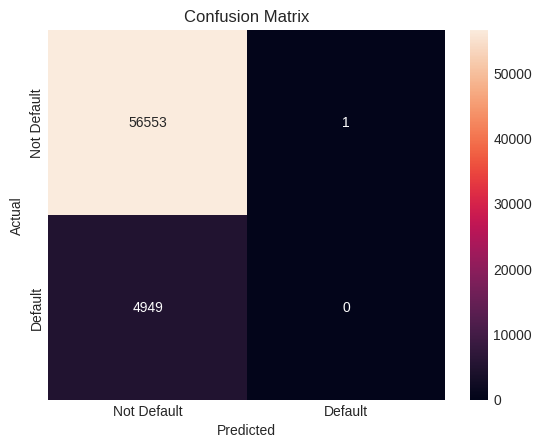

In [ ]:
# Inisialisasi model logistic regression dengan solver='liblinear' dan max_iter yang lebih besar
model = LogisticRegression(solver='liblinear', max_iter=1000)

# run model menggunakan data train
model.fit(X_train, y_train)

# Melakukan prediksi pada data validasi
y_pred = model.predict(X_val)

# Evaluasi model
accuracy = accuracy_score(y_val, y_pred)
precision = precision_score(y_val, y_pred)
recall = recall_score(y_val, y_pred)
f1 = f1_score(y_val, y_pred)
confusion = confusion_matrix(y_val, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("Confusion Matrix:\n", confusion)

labels = ['Not Default', 'Default']
sns.heatmap(confusion, annot=True, fmt="d", xticklabels=labels, yticklabels=labels)
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

In [ ]:
model = LogisticRegression()

cv_scores = cross_val_score(model, X_train, y_train, cv=5)

print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", cv_scores.mean())
print("Standard Deviation:", cv_scores.std())


Cross-Validation Scores: [0.9192106  0.9192106  0.91916995 0.91920896 0.91920896]
Mean CV Score: 0.9192018146332195
Standard Deviation: 1.5948011626691967e-05


1. Confusion matrix menunjukkan bahwa model memiliki jumlah false negative (FN) yang tinggi, dengan 4949 sampel yang salah diklasifikasikan sebagai negatif. Hal ini menunjukkan bahwa model memiliki kesulitan dalam mengidentifikasi sampel yang sebenarnya termasuk dalam kelas 1.

2. Hasil cross-validation menunjukkan bahwa model memiliki tingkat konsistensi yang tinggi dengan mean CV score sebesar 0.9192. Standard deviation yang rendah menunjukkan bahwa model cenderung memiliki kinerja yang stabil pada dataset yang berbeda. terlihat bahwa model logistic regression tidak efektif dalam memprediksi sampel yang termasuk dalam kelas 1 (positif).

### RandomForest

In [ ]:
data = pd.read_csv('application_train.csv')

In [ ]:
numeric_cols = data.select_dtypes(include='number').columns
data[numeric_cols] = data[numeric_cols].fillna(data[numeric_cols].mean())


categorical_cols = data.select_dtypes(include='object').columns
data[categorical_cols] = data[categorical_cols].fillna(data[categorical_cols].mode().iloc[0])


In [ ]:
le = LabelEncoder()
train[categorical_cols] = train[categorical_cols].apply(lambda x: le.fit_transform(x))

X = train.drop('TARGET', axis=1)
y = train['TARGET']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)


y_pred = rf_model.predict(X_test)


print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       0.92      1.00      0.96     56554
           1       0.58      0.00      0.01      4949

    accuracy                           0.92     61503
   macro avg       0.75      0.50      0.48     61503
weighted avg       0.89      0.92      0.88     61503



In [ ]:
# Memprediksi nilai untuk data uji
y_pred = rf_model.predict(X_test)

# Evaluasi model menggunakan metrik regresi
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Menampilkan metrik evaluasi
print("Mean Absolute Error:", mae)
print("Mean Squared Error:", mse)
print("R-squared:", r2)


Mean Absolute Error: 0.08040258198787051
Mean Squared Error: 0.08040258198787051
R-squared: -0.08663031021236778


1. Dari hasil Classification Report pada model Random Forest, terlihat bahwa klasifikasi untuk kelas 1 (positif) juga memiliki hasil yang tidak memuaskan. Precision untuk kelas 1 adalah 0.58, yang mengindikasikan bahwa dari semua prediksi yang diklasifikasikan sebagai kelas 1, hanya sekitar 58% yang benar. Recall untuk kelas 1 adalah 0.00, yang menunjukkan bahwa tidak ada data kelas 1 yang berhasil terdeteksi dengan benar. F1-score untuk kelas 1 adalah 0.01, yang menunjukkan ketidakmampuan model dalam mengklasifikasikan data pada kelas 1 dengan baik.

2. Selain itu, metrik evaluasi lainnya seperti Mean Absolute Error (MAE), Mean Squared Error (MSE), dan R-squared juga memberikan informasi tentang kinerja model secara keseluruhan. MAE dan MSE merupakan ukuran dari seberapa baik model dapat memprediksi nilai target dengan akurasi tinggi, di mana nilai yang lebih rendah menunjukkan performa yang lebih baik. Dalam hal ini, MAE dan MSE memiliki nilai yang sama, yaitu 0.08040258198787051. Nilai R-squared yang negatif (-0.08663031021236778) menunjukkan bahwa model tidak cocok dengan data dengan baik.

### LightGBM

In [ ]:
# Load data
data = pd.read_csv('application_train.csv')

In [ ]:
# Bagi train menjadi fitur dan target
X = train.drop('TARGET', axis=1)
y = train['TARGET']

cat_cols = X.select_dtypes(include=['object']).columns
for col in cat_cols:
    le = LabelEncoder()
    X[col] = le.fit_transform(X[col].astype(str))


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = lgb.LGBMClassifier(boosting_type='gbdt', objective='binary', metric='binary_logloss')

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

report = classification_report(y_test, y_pred)
print(report)


              precision    recall  f1-score   support

           0       0.92      1.00      0.96     56554
           1       0.53      0.02      0.04      4949

    accuracy                           0.92     61503
   macro avg       0.73      0.51      0.50     61503
weighted avg       0.89      0.92      0.88     61503



Dari hasil pada model LightGBM, terlihat bahwa klasifikasi untuk kelas 1 (positif) memiliki hasil yang kurang memuaskan. Precision untuk kelas 1 adalah 0.51, yang mengindikasikan bahwa dari semua prediksi yang diklasifikasikan sebagai kelas 1, hanya sekitar 51% yang benar. Recall untuk kelas 1 adalah 0.02, yang menunjukkan bahwa hanya sekitar 2% dari total data kelas 1 yang berhasil terdeteksi dengan benar. F1-score untuk kelas 1 adalah 0.04, yang mencerminkan keseimbangan antara precision dan recall. Hal ini menunjukkan bahwa model LightGBM mengalami kesulitan dalam mengenali dan mengklasifikasikan data pada kelas 1 dengan akurasi yang tinggi.

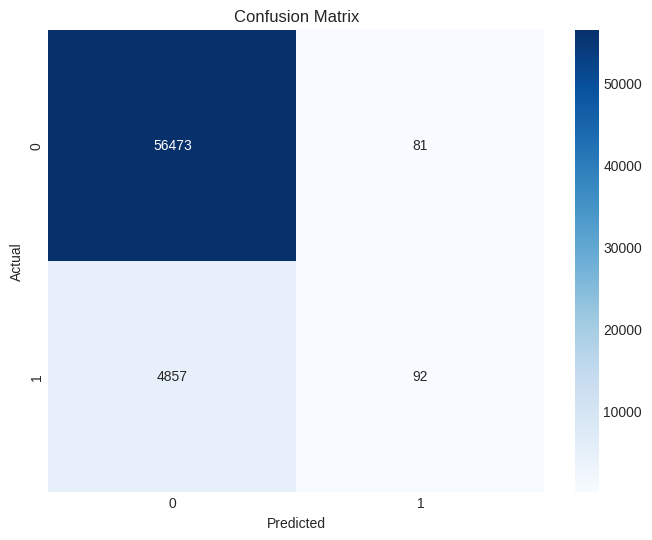

In [ ]:
cm = confusion_matrix(y_test, y_pred)

# Menampilkan confusion matrix menggunakan heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

## Evaluation

### ROC, logistic regression and lightgbm


In [ ]:
data = pd.read_csv('application_train.csv')

# Menghapus kolom dengan tipe data string
data_numeric = data.select_dtypes(exclude='object')

# Mengisi nilai-nilai yang hilang dengan mean
data_numeric = data_numeric.fillna(data_numeric.mean())

# Memisahkan fitur dan label
X = data_numeric.drop('TARGET', axis=1)
y = data_numeric['TARGET']

# Memisahkan data menjadi train dan test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Regresi Logistik
logreg = LogisticRegression()
logreg.fit(X_train, y_train)

# Prediksi probabilitas kelas positif untuk Regresi Logistik
y_pred_logreg = logreg.predict_proba(X_test)[:, 1]

# Menghitung ROC AUC score untuk Regresi Logistik
roc_logreg = roc_auc_score(y_test, y_pred_logreg)

# LightGBM
lgbm = LGBMClassifier()
lgbm.fit(X_train, y_train)

# Prediksi probabilitas kelas positif untuk LightGBM
y_pred_lgbm = lgbm.predict_proba(X_test)[:, 1]

# Menghitung ROC AUC score untuk LightGBM
roc_lgbm = roc_auc_score(y_test, y_pred_lgbm)

# Menampilkan hasil perbandingan
print(f"ROC AUC (Regresi Logistik): {roc_logreg}")
print(f"ROC AUC (LightGBM): {roc_lgbm}")

# Classification performance report untuk Regresi Logistik
print("Classification Report (Regresi Logistik):")
print(classification_report(y_test, y_pred_logreg > 0.5))

# Classification performance report untuk LightGBM
print("Classification Report (LightGBM):")
print(classification_report(y_test, y_pred_lgbm > 0.5))

ROC AUC (Regresi Logistik): 0.6205168447556454
ROC AUC (LightGBM): 0.7519884560323411
Classification Report (Regresi Logistik):
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     56554
           1       0.00      0.00      0.00      4949

    accuracy                           0.92     61503
   macro avg       0.46      0.50      0.48     61503
weighted avg       0.85      0.92      0.88     61503

Classification Report (LightGBM):
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     56554
           1       0.54      0.01      0.03      4949

    accuracy                           0.92     61503
   macro avg       0.73      0.51      0.49     61503
weighted avg       0.89      0.92      0.88     61503



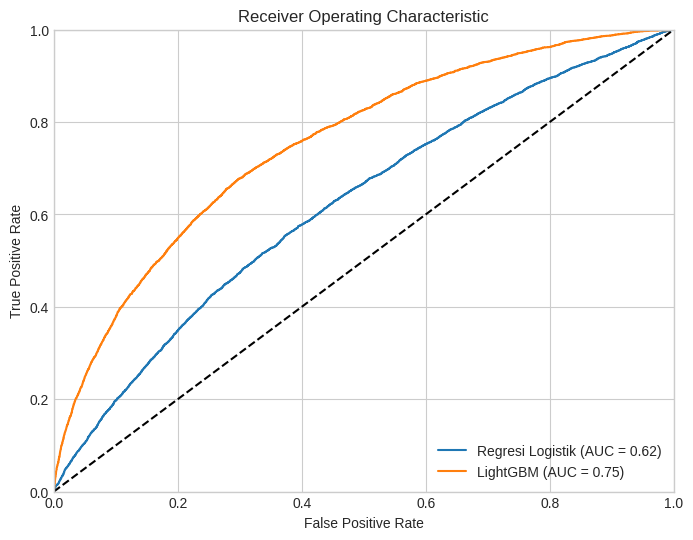

In [ ]:
# Membaca data dari file CSV
data = pd.read_csv('application_train.csv')

# Menghapus kolom dengan tipe data string
data_numeric = data.select_dtypes(exclude='object')

# Mengisi nilai-nilai yang hilang dengan mean
data_numeric = data_numeric.fillna(data_numeric.mean())

# Memisahkan fitur dan label
X = data_numeric.drop('TARGET', axis=1)
y = data_numeric['TARGET']

# Memisahkan data menjadi train dan test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Regresi Logistik
logreg = LogisticRegression()
logreg.fit(X_train, y_train)

# Prediksi probabilitas kelas positif untuk Regresi Logistik
y_pred_logreg = logreg.predict_proba(X_test)[:, 1]

# Menghitung ROC AUC score untuk Regresi Logistik
roc_logreg = roc_auc_score(y_test, y_pred_logreg)

# LightGBM
lgbm = LGBMClassifier()
lgbm.fit(X_train, y_train)

# Prediksi probabilitas kelas positif untuk LightGBM
y_pred_lgbm = lgbm.predict_proba(X_test)[:, 1]

# Menghitung ROC AUC score untuk LightGBM
roc_lgbm = roc_auc_score(y_test, y_pred_lgbm)

# Menghitung nilai false positive rate (FPR) dan true positive rate (TPR) untuk Regresi Logistik
fpr_logreg, tpr_logreg, _ = roc_curve(y_test, y_pred_logreg)

# Menghitung nilai false positive rate (FPR) dan true positive rate (TPR) untuk LightGBM
fpr_lgbm, tpr_lgbm, _ = roc_curve(y_test, y_pred_lgbm)

# Menampilkan grafik ROC
plt.figure(figsize=(8, 6))
plt.plot(fpr_logreg, tpr_logreg, label='Regresi Logistik (AUC = {:.2f})'.format(roc_logreg))
plt.plot(fpr_lgbm, tpr_lgbm, label='LightGBM (AUC = {:.2f})'.format(roc_lgbm))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


1. ROC AUC: Nilai ROC AUC (Area Under the Receiver Operating Characteristic Curve) memberikan gambaran tentang kemampuan model dalam membedakan kelas yang benar. Perbandingan nilai ROC AUC antara Regresi Logistik (0.6205) dan LightGBM (0.7520) menunjukkan bahwa LightGBM memiliki performa yang lebih baik dalam memprediksi kelas dengan akurasi yang lebih tinggi.

2. Classification Report: Pada Classification Report, terdapat informasi mengenai precision, recall, dan f1-score untuk setiap kelas target. Analisis terhadap laporan ini dapat memberikan pemahaman tentang sejauh mana model dapat mengenali kelas yang benar. Dalam contoh ini, terlihat bahwa Regresi Logistik memiliki precision, recall, dan f1-score yang rendah untuk kelas 1, sedangkan LightGBM menunjukkan peningkatan performa yang lebih baik untuk kelas 1 dibandingkan Regresi Logistik.

### confusion matrix logistic regression and lightgbm


In [ ]:
# Load the dataset
data = pd.read_csv('application_train.csv')

features = ['AMT_INCOME_TOTAL','AMT_CREDIT']
target = 'TARGET'
X = data[features]
y = data[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

logreg = LogisticRegression()
logreg.fit(X_train, y_train)

# Predict using Logistic Regression
y_pred_logreg = logreg.predict(X_test)

# Confusion matrix for Logistic Regression
cm_logreg = confusion_matrix(y_test, y_pred_logreg)
print("Confusion Matrix - Logistic Regression:")
print(cm_logreg)

# Classification performance report for Logistic Regression
cr_logreg = classification_report(y_test, y_pred_logreg)
print("Classification Report - Logistic Regression:")
print(cr_logreg)

# LightGBM
lgbm = lgb.LGBMClassifier()
lgbm.fit(X_train, y_train)

# Predict using LightGBM
y_pred_lgbm = lgbm.predict(X_test)

# Confusion matrix for LightGBM
cm_lgbm = confusion_matrix(y_test, y_pred_lgbm)
print("Confusion Matrix - LightGBM:")
print(cm_lgbm)

# Classification performance report for LightGBM
cr_lgbm = classification_report(y_test, y_pred_lgbm)
print("Classification Report - LightGBM:")
print(cr_lgbm)


Confusion Matrix - Logistic Regression:
[[56554     0]
 [ 4949     0]]
Classification Report - Logistic Regression:
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     56554
           1       0.00      0.00      0.00      4949

    accuracy                           0.92     61503
   macro avg       0.46      0.50      0.48     61503
weighted avg       0.85      0.92      0.88     61503

Confusion Matrix - LightGBM:
[[56554     0]
 [ 4949     0]]
Classification Report - LightGBM:
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     56554
           1       0.00      0.00      0.00      4949

    accuracy                           0.92     61503
   macro avg       0.46      0.50      0.48     61503
weighted avg       0.85      0.92      0.88     61503



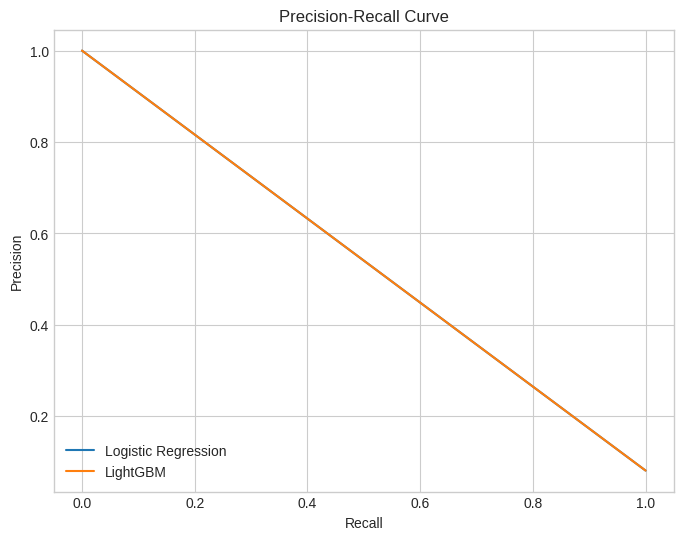

In [ ]:
# Calculate Precision and Recall for Logistic Regression
precision_logreg, recall_logreg, _ = precision_recall_curve(y_test, y_pred_logreg)

# Calculate Precision and Recall for LightGBM
precision_lgbm, recall_lgbm, _ = precision_recall_curve(y_test, y_pred_lgbm)

# Plot Precision-Recall Curve
plt.figure(figsize=(8, 6))
plt.plot(recall_logreg, precision_logreg, label='Logistic Regression')
plt.plot(recall_lgbm, precision_lgbm, label='LightGBM')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc='lower left')
plt.show()


1. Dari hasil Confusion Matrix, terlihat bahwa klasifikasi untuk kelas 1 (positif) pada kedua model, yaitu Regresi Logistik dan LightGBM, tidak memiliki prediksi yang akurat. Hal ini dapat dilihat dari nilai precision, recall, dan f1-score yang rendah untuk kelas 1.

2. Pada kedua model, terlihat bahwa jumlah prediksi untuk kelas 1 adalah 0 pada Confusion Matrix. Ini mengindikasikan bahwa model tidak mampu memprediksi kelas 1 dengan benar, sehingga nilai precision dan recall untuk kelas 1 menjadi 0. Kedua model memiliki tingkat akurasi yang tinggi untuk klasifikasi kelas 0, tetapi tidak dapat mengklasifikasikan kelas 1 dengan baik.